### Calculating the KL Divergences

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

from collections import Counter


from itertools import *

import json
import os
import time
import sys
import xmltodict
from datetime import datetime

# Novelty measures

from numpy.linalg import norm
from scipy.stats import entropy
from scipy.spatial.distance import hamming
from scipy.spatial.distance import euclidean
from sklearn.metrics import mutual_info_score
from scipy.stats import entropy

from gensim.models import LdaModel
# Remove rare and common tokens.
from gensim.corpora import Dictionary
from gensim.models import TfidfModel

entropy_fix = np.log2(np.e)

In [2]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [8]:
PATH = '/Users/alexandrarottenkolber/Documents/02_Hertie_School/Master thesis/Master_Thesis_Hertie/data_analysis/'

In [10]:
#file = "./models/lda_model_210616"
#file = "./models/lda_model_concat_self_tuned"
#file = "./models/lda_model_concat_POSTag_self_tuned"
#file = "./models/lda_model_concat_POSTag_self_tuned_all_sorted_shuffle"
file = "./models/lda_model_concat_POSTag_self_tuned_all_sorted"
lda_model = LdaModel.load(file)

FileNotFoundError: [Errno 2] No such file or directory: './models/lda_model_concat_POSTag_self_tuned_all_sorted'

In [4]:
#with open('../../data/written/data_ready.txt', 'r') as infile:
#with open('../../data/written/data_ready_concat.txt', 'r') as infile:
with open('../../data/written/data_ready_concat_POSTag_all_sorted.txt', 'r') as infile:
    data_ready = json.load(infile)
infile.close()

In [5]:
len(data_ready) 

121387

In [6]:
#with open('../../data/written/id2rede_12_19.txt', 'r') as infile:
#with open('../../data/written/id2rede_12_19_concat_inshape.txt', 'r') as infile:
with open('../../data/written/id2rede_concat_POSTag_inshape.txt', 'r') as infile:
    id2rede_12_19 = json.load(infile)
infile.close()

#for key in id2rede_12_19.keys(): 
#    if id2rede_12_19[key]["date"] == '2003-12-20': 
#        id2rede_12_19[key]["date"] = '2003-02-20'

In [7]:
id2rede_12_19['1000281']["date"], id2rede_12_19['1000281']["date_control"]

('2017-11-22', '2017-11-22')

In [8]:
len(id2rede_12_19)

121387

In [9]:
id2rede_12_19['1000281'].keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control'])

### A look at topics 

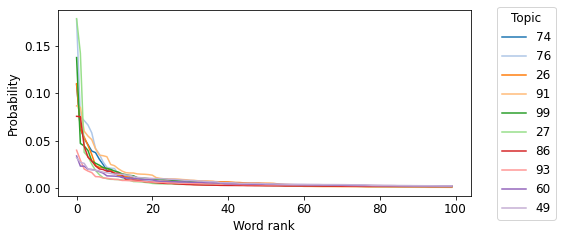

In [167]:
# change default figure and font size
sns.set_palette(sns.color_palette("tab20"))
plt.rcParams['figure.figsize'] = 8, 3.5
plt.rcParams['font.size'] = 12
#plt.yscale('log')


# top 100 words by weight in each topic
top_n_words = 100
n_topics = 10
topics = lda_model.show_topics(
    num_topics = n_topics, num_words = top_n_words, formatted = False)

labels = []
for name, infos in topics:
    labels.append(name)
    probs = [prob for _, prob in infos]
    plt.plot(range(top_n_words), probs)

plt.xlabel('Word rank')
plt.ylabel('Probability')
#plt.title('Share of Top 100 Words in each Topic')
plt.legend(labels, title='Topic', bbox_to_anchor=(1.05, 1.05), loc='upper left')
#plt.yscale("log")
#plt.xscale("log")

#plt.show()

plt.tight_layout()
plt.savefig("./figures_wochen/Share_of_Top_100_Words_in_each_Topic_nottfidf.pdf", dpi=350, facecolor='w', edgecolor='w', format="pdf",
        transparent=False, bbox_inches=None, pad_inches=0.1)

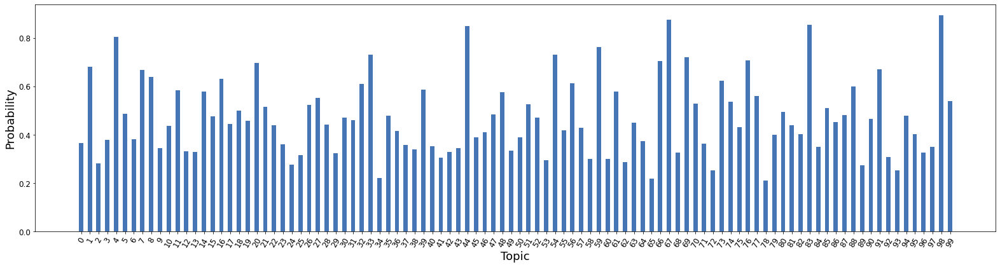

In [165]:
## top 20 words by weight in each topic
n_topics = 100

# total weight assigned by each topic to its top 10 words
top_probs = []
top_n_words = 20
topics = lda_model.show_topics(num_topics=n_topics, num_words = top_n_words, formatted = False)
#print(topics[10])
for _, infos in topics:
    prob = sum([prob for _, prob in infos])
    top_probs.append(prob)

ind = np.arange(n_topics)
width = 0.5

fig, ax = plt.subplots(figsize = (22,6))

ax.bar((ind - (width / 20)), top_probs, width, color = '#4575b4')# '#56B4E9',   '#E69F00', '#F0E442'
ax.set_xticks(ind)
#ax.bar(top_probs, width, color = 'lightcoral')

plt.xlabel('Topic', fontsize = 18)
plt.ylabel('Probability', fontsize = 18)
#plt.title('Total Probability of Top 10 Words in each Topic')
#plt.xlim(-0.5, 9.5)
plt.xticks(rotation=60)
#plt.ylim(0, 0.15)

plt.tight_layout()
plt.savefig("./figures_wochen/Total_probability_of_top_20_words_per_topic_nottfidf.pdf", dpi=350, facecolor='w', edgecolor='w', format="pdf",
        transparent=False, bbox_inches=None, pad_inches=0.1)



In [164]:
counter = 0

for prob in top_probs: 
    if prob > 0.4:
        counter +=1
counter

35

In [13]:
for i in range(100):
    print(lda_model.print_topic(i, 20))
    print("\n")

0.056*"bahn" + 0.039*"strass" + 0.033*"schien" + 0.030*"verkehr" + 0.027*"infrastruktur" + 0.022*"mobilitat" + 0.016*"streck" + 0.015*"ag" + 0.014*"verkehrspolit" + 0.013*"weinberg" + 0.013*"flughaf" + 0.012*"kilomet" + 0.011*"investition" + 0.011*"stuttgart" + 0.010*"autobahn" + 0.010*"verkehrsminist" + 0.009*"opnv" + 0.009*"zug" + 0.008*"guterverkehr" + 0.008*"bund"


0.383*"einsatz" + 0.068*"operation" + 0.024*"genes" + 0.023*"helf" + 0.022*"flugzeug" + 0.017*"feuerwehr" + 0.016*"thw" + 0.014*"besatz" + 0.013*"ort" + 0.012*"wehrmacht" + 0.011*"schutz" + 0.011*"katastroph" + 0.010*"hilfswerk" + 0.009*"katastrophenschutz" + 0.009*"eid" + 0.008*"angriff" + 0.008*"szenari" + 0.008*"maschin" + 0.008*"bevolkerungsschutz" + 0.007*"bevolker"


0.044*"haushalt" + 0.034*"milliard" + 0.029*"schuld" + 0.016*"finanzminist" + 0.016*"bundeshaushalt" + 0.014*"ausgab" + 0.013*"investition" + 0.012*"bundesfinanzminist" + 0.012*"wachstum" + 0.011*"polit" + 0.010*"bund" + 0.010*"koalition" + 0.009*"fin

In [13]:
#get topics per document 
#np.array(lda_model.get_document_topics(doc2bow_sorted[day2id2rede_filtered[date][ID]['num_in_row']], minimum_probability=0.0))[:,1]
#lda_model.get_document_topics(doc2bow_sorted[day2id2rede_filtered[date][ID]['num_in_row']], minimum_probability=0.0)

### Check for roles of people 

In [10]:
id2rede_12_19["1000017"].keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control'])

In [11]:
sorted_id2rede_12_19_keys = sorted(list(id2rede_12_19.keys()))#[:10]


dates = []
datetime_dates = []
id2date = {}
for key in sorted_id2rede_12_19_keys: 
    dates.append(id2rede_12_19[key]["date"])
    datetime_dates.append(datetime.strptime(id2rede_12_19[key]["date"], '%Y-%m-%d'))
    id2date[key] = datetime.strptime(id2rede_12_19[key]["date"], '%Y-%m-%d')

unique_dates = pd.Series(dates).unique()

day2id2rede = {}
for date in unique_dates: 
    day2id2rede[date] = {}
    
for key in id2rede_12_19.keys():
    
    temp_key = id2rede_12_19[key]["date"]
    temp_dic = day2id2rede[temp_key].copy()
    temp_dic[key] = id2rede_12_19[key]
    
    day2id2rede[temp_key] = temp_dic

In [12]:
count_org = 0

for day in day2id2rede.keys():
    count_org += len(day2id2rede[day].keys())

In [13]:
count_org

121387

In [14]:
#with open('../../data/written/day2id2rede.txt', 'w') as outfile: 
#    json.dump(day2id2rede, outfile) 
#outfile.close()

In [15]:
#day2id2rede['2017-10-24']['1000000']#'politicianId', lastName, firstName, positionLong, positionShort

In [16]:
#id2rede_12_19["471599"]["data_ready"]#.keys()

In [17]:
#id2rede_12_19["471599"]

In [18]:
PolID2info = {}
for speech in id2rede_12_19.keys():
    temp_dic = {}

    politicianId = id2rede_12_19[speech]['politicianId']
    temp_dic['lastName'] = id2rede_12_19[speech]['lastName']
    temp_dic['firstName'] = id2rede_12_19[speech]['firstName']
    temp_dic['positionLong'] = id2rede_12_19[speech]['positionLong']
    temp_dic['positionShort'] = id2rede_12_19[speech]['positionShort']

    PolID2info[politicianId] = temp_dic

In [19]:
for rede in day2id2rede['2021-05-07'].keys(): 
    if day2id2rede['2021-05-07'][rede]["lastName"] == "Köhler": 
        print(rede)

1060836


In [20]:
#filepath_stammdaten = "../../data/MdB-Stammdaten-data/MDB_STAMMDATEN.XML"
#with open(filepath_stammdaten) as infile:
#    stammd_dic = xmltodict.parse(infile.read())

In [21]:
# Read in data

with open('../../data/written/key2Party.txt', 'r') as infile:
    key2Party = json.load(infile)
infile.close()

In [22]:
#len(errors_for)#, errors_for[0] #255

In [23]:
#datetime.strftime(datetime.strptime(stammd_dic['DOCUMENT']['MDB'][17]["BIOGRAFISCHE_ANGABEN"]['GEBURTSDATUM'], "%d.%m.%Y"), "%Y")#['NACHNAME']

In [24]:
for PolID in PolID2info.keys(): 
    for key in key2Party.keys(): 
        if (PolID2info[PolID]["lastName"].lower() == key2Party[key]["NACHNAME"].lower()) & (PolID2info[PolID]["firstName"].lower() == key2Party[key]["VORNAME"].lower()):
            PolID2info[PolID]["PARTY"] = key2Party[key]['PARTY']
            PolID2info[PolID]["WPs"] = key2Party[key]["WPs"]    
            PolID2info[PolID]["BORN"] = key2Party[key]["BORN"]       

In [25]:
#look up specific MPs
for PolID in PolID2info.keys(): 
    if PolID2info[PolID]["lastName"].lower() == "köhler": 
        print(PolID, PolID2info[PolID]["firstName"], PolID2info[PolID]["lastName"])

11004786 Lukas Köhler
11001154 Volkmar Köhler
11001151 Hans-Ulrich Köhler
11003568 Heinz Köhler


In [26]:
with open('../../data/written/PolID2info.txt', 'w') as outfile: 
    json.dump(PolID2info, outfile) 
outfile.close()

In [27]:
#PolID2info["11004786"]#.keys()

#### Roles in the parliament

In [28]:
positionShort_ls = []
for key in PolID2info.keys():
    positionShort_ls.append(PolID2info[key]['positionShort'])

positionShort_ls = pd.Series(positionShort_ls).unique()

In [29]:
positionShort_ls

array(['Member of Parliament', 'Minister', 'Guest', 'Secretary of State',
       'Presidium of Parliament', 'Chancellor'], dtype=object)

## Distance measures

In [30]:
# Novelty measures IMPORTED FROM CHICO's Script

from numpy.linalg import norm
from scipy.stats import entropy
from scipy.spatial.distance import hamming
from scipy.spatial.distance import euclidean
from sklearn.metrics import mutual_info_score


entropy_fix = np.log2(np.e)

def rel_entr(P, Q):                
    return entropy(P,Q)*entropy_fix

def JSD(P, Q):
    _P = P / norm(P, ord=1)
    _Q = Q / norm(Q, ord=1)
    _M = 0.5 * (_P + _Q)
    return 0.5 * (rel_entr(_P, _M) + rel_entr(_Q, _M))

def BCD(P,Q):
    _P = np.array(P / norm(P, ord=1),dtype=np.float32)
    _Q = np.array(Q / norm(Q, ord=1),dtype=np.float32)
    BC = np.dot(np.sqrt(_P),np.sqrt(_Q))
    return -np.log2(BC)    

def MI(_P,_Q):
    return mutual_info_score(_P,_Q)

def novelty(p,q, metric='KL'):
    
    if metric=='KL':
        return rel_entr(p,q)
    elif metric=='hamming':
        return hamming(p,q)
    elif metric=='euclidean':
        return euclidean(p,q)
    elif metric=='JSD':
        return JSD(p,q)
    elif metric=='BCD':
        return BCD(p,q)
    elif metric=='MI':
        return MI(p,q)
    else:
        return 0

### Differences between speeches over time 

In [31]:
id2date_df = pd.DataFrame.from_dict(id2date, orient='index').reset_index().rename(columns = {"index": "key", 0: "date"})

In [32]:
id2date_df["key_number"] = id2date_df["key"].map(lambda x: int(x)) #.head() #.sort_values(by = "key")

<AxesSubplot:xlabel='key_number'>

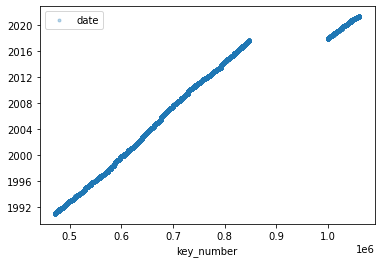

In [33]:
id2date_df.sort_values(by = 'key_number').plot(x='key_number', y='date', marker = ".", alpha = 0.3, linewidth = 0)

In [34]:
id2date_df.head()

,key,date,key_number
0,1000002,2017-10-24,1000002
1,1000004,2017-10-24,1000004
2,1000006,2017-10-24,1000006
3,1000008,2017-10-24,1000008
4,1000010,2017-10-24,1000010


In [36]:
#plt.rcParams["figure.figsize"] = (20,10)
#id2date_df.sort_values(by = 'key_number').plot(x='key_number', y='date', marker = ".", linewidth = 0)
#plt.ylim(12000, 12500)
#plt.xlim(645000, 645500)

### Calculation of divergence measures -- naive approach

- calculate the diiference between to consecutive speeches per day

scipy.stats.entropy(pk, qk=None, base=None, axis=0)       
with S(P|Q) = sum(pk * log(pk / qk)

In [37]:
sortes_dates = [date.strftime("%Y-%m-%d") for date in sorted(datetime_dates)]
sortes_dates = pd.Series(sortes_dates).unique()

data_ready_sorted = []
for day in sortes_dates: 
    sorted_day_keys = sorted(list(day2id2rede[day].keys()))
    for key in sorted_day_keys:
        data_ready_sorted.append(day2id2rede[day][key]["data_ready"])
data_ready_sorted = [item for sublist in data_ready_sorted for item in sublist]

In [38]:
day2id2rede[day][key]["data_ready"]

[['frau',
  'prasidentin',
  'kolleginn',
  'kolleg',
  'dam',
  'herr',
  'debatt',
  'antrag',
  'link',
  'storytelling',
  'red',
  'frau',
  'bull-bischoff',
  'freud',
  'debatt',
  'bildungsfoderalismus',
  'antrag',
  'link',
  'genau',
  'red',
  'ausblend',
  'link',
  'verfassungswirk',
  'bildungsfoderalismus',
  'deutschland',
  'grundgesetz',
  'antrag',
  'linkspartei',
  'verantwort',
  'land',
  'schulbild',
  'schuld',
  'bund',
  'jahrzehnt',
  'link',
  'kooperationsverbot',
  'kampfbegriff',
  'antrag',
  'link',
  'link',
  'antrag',
  'meinung',
  'positiv',
  'forder',
  'bildungsstandard',
  'lang',
  'versag',
  'kultusministerkonferenz',
  'bereich',
  'wortwahl',
  'link',
  'antrag',
  'vielfalt',
  'dezentralitat',
  'pramiss',
  'identitat',
  'bildung',
  'landerzustand',
  'entscheid',
  'grund',
  'zusammenarbeit',
  'sach',
  'bildungspolit',
  'weg',
  'linksfraktion',
  'polit',
  'betracht',
  'wirklich',
  'ergebnis',
  'reform',
  'bildungsfodera

In [39]:
sorted_keys = []
for day in list(day2id2rede.keys()): 
    [sorted_keys.append(int(key)) for key in day2id2rede[day].keys()]
sorted_keys = [str(key) for key in sorted(sorted_keys)]

In [40]:
key2num = {}
for num, key in enumerate(sorted_keys): 
    key2num[str(key)] = num

In [41]:
len(key2num)

121387

In [42]:
for day in day2id2rede.keys(): 
    for speech in day2id2rede[day].keys():
        day2id2rede[day][speech]["num_in_row"] = key2num[speech]

In [43]:
#day2id2rede["2020-03-31"].keys()

In [44]:
day2id2rede[sortes_dates[0]][sorted_keys[6]]["num_in_row"] # assignment worked well

6

In [45]:
#for key in sorted([int(key) for key in day2id2rede['2020-09-16'].keys()]): 
#    print(day2id2rede['2020-09-16'][str(key)]["num_in_row"])

In [46]:
print(len(day2id2rede[sortes_dates[100]]["494730"]["data_ready"][0]))
print(len(day2id2rede[sortes_dates[100]]["494730"]["concatSpeech"].split(" ")))#.keys()#[key]["data_ready"]

234
1370


In [47]:
#day2id2rede[sortes_dates[100]]["494730"]

In [48]:
# Create a dictionary representation of the documents.
dictionary_sorted = Dictionary(data_ready)

# Filter out words that occur in less than 20 documents, or more than 50% of the documents.
#dictionary.filter_extremes(no_below=20, no_above=0.5)
dictionary_sorted.filter_extremes(no_below=20, no_above=0.4)

# Bag-of-words representation of the documents. (This is the CORPUS!!!!)
doc2bow_sorted = [dictionary_sorted.doc2bow(doc) for doc in data_ready]

#tfidf = TfidfModel(doc2bow_sorted)
#doc2bow_sorted = tfidf[doc2bow_sorted]

## Topic Model

In [49]:
#import pyLDAvis.gensim_models

In [50]:
#dir(dictionary_sorted)

In [51]:
#Creating Topic Distance Visualization 
#pyLDAvis.enable_notebook()
#pyLDAvis.gensim_models.prepare(lda_model, doc2bow_sorted, dictionary_sorted)

## Content

In [52]:
#len(sorted_keys), len(data_ready_sorted), len(doc2bow_sorted), len(key2num)

In [53]:
day2id2rede["2019-12-19"]['1034534']['num_in_row']#.keys()

112507

In [54]:
#key2num['1021756']

In [55]:
for day in day2id2rede.keys():
    for key in day2id2rede[day].keys():
        #day2id2rede[day][key]["rede_no"] = key2num[key] 
        day2id2rede[day][key]["doc2bow"] = doc2bow_sorted[key2num[key]]

In [56]:
day2id2rede["2019-03-21"]['1021758'].keys()  #['id', 'session', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'speechContent', 'factionId', 'documentUrl', 'positionShort', 'positionLong', 'date', 'data_ready', 'num_in_row', 'rede_no', 'doc2bow']

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow'])

In [57]:
# Check whether documents match
day2id2rede["2019-03-21"]['1021758']["doc2bow"]
df = pd.DataFrame(day2id2rede["2019-03-21"]['1021758']["doc2bow"], columns =['word_id', 'counts'])
df.sort_values(by = ["counts"]).tail(10)

,word_id,counts
43,681,2
59,1840,2
31,450,2
36,522,3
106,27101,3
18,258,3
7,101,4
57,1461,4
107,27722,6
58,1548,6


In [58]:
dictionary_sorted.token2id["brit"]

1548

In [59]:
#Counter(day2id2rede["2019-03-21"]['1021758']["data_ready"][0]).most_common()

In [60]:
#day2id2rede["2019-12-19"]['1034534']["doc2bow"]
#df = pd.DataFrame(day2id2rede["2019-12-19"]['1034534']["doc2bow"], columns =['word_id', 'counts'])
#df.sort_values(by = ["counts"]).tail(10)

In [61]:
#doc2bow_sorted[day2id2rede_filtered["2019-12-19"]['1034534']['num_in_row']]
#day2id2rede_filtered["2019-12-19"]['1034534']#['num_in_row']
#len(doc2bow_sorted), len(day2id2rede_filtered), len(day2id2rede)
#day2id2rede["2019-12-19"]['1034534']['num_in_row']
#day2id2rede_filtered["2019-12-19"]['1034534']['num_in_row']

In [62]:
#key2num['1034534']

In [63]:
#dictionary_sorted.token2id["debatt"]

In [64]:
#Counter(day2id2rede["2019-12-19"]['1034534']["data_ready"][0]).most_common()

Speech to doc2bow mapping is correct!!!

#### Start calcualting the KL divergencies

Roles are 
'Member of Parliament', 'Secretary of State', 'Minister', 'Presidium of Parliament', 'Chancellor', 'Guest', 'Not found'

In [65]:
import copy
from gensim.matutils import kullback_leibler

In [66]:
day2id2rede_filtered = copy.deepcopy(day2id2rede) 

In [67]:
day2id2rede["2019-12-19"]['1034534']['num_in_row']
day2id2rede_filtered["2019-12-19"]['1034534']['num_in_row']

112507

In [68]:
#day2id2rede_filtered = day2id2rede.copy()

In [69]:
#len(keys_to_be_deleted)

In [70]:
#for tup in keys_to_be_deleted: 
#    del day2id2rede_filtered[tup[0]][tup[1]]

In [71]:
count = 0
count_filtered = 0
for day in day2id2rede.keys():
    count += len(day2id2rede[day].keys())
    
for day in day2id2rede_filtered.keys():
    count_filtered += len(day2id2rede_filtered[day].keys())
    
count, count_filtered

(121387, 121387)

In [72]:
#keys_to_be_deleted[0]

In [73]:
#day2id2rede_filtered['2017-11-21']["1000101"]["positionShort"]#.keys()
#day2id2rede['2017-11-21']["1000101"]["positionShort"]#.keys()

In [74]:
# create a list with sorted dates 

sorted_day2id2rede_filtered_keys = sorted(list(day2id2rede_filtered.keys()))#[:10]

dates_filtered = []
datetime_dates_filtered = []
for date in sorted_day2id2rede_filtered_keys: 
    dates_filtered.append(date)
    datetime_dates_filtered.append(datetime.strptime(date, '%Y-%m-%d'))

sorted_dates_filtered = [date.strftime("%Y-%m-%d") for date in sorted(datetime_dates_filtered)]
sorted_dates_filtered = pd.Series(sorted_dates_filtered).unique()

In [75]:
# create a list with sorted keys
IDs_filtered = []

for date in day2id2rede_filtered.keys(): 
    for ID in day2id2rede_filtered[date].keys():
        IDs_filtered.append(int(ID))
IDs_filtered_sorted = [str(ID) for ID in sorted(IDs_filtered)]

In [76]:
ID2num_filtered = {}
for num, ID in enumerate(IDs_filtered_sorted): 
    ID2num_filtered[ID] = num
    
for date in day2id2rede_filtered.keys(): 
    for ID in day2id2rede_filtered[date].keys():
        day2id2rede_filtered[date][ID]["filtered_no"] = ID2num_filtered[ID]

In [77]:
#day2id2rede_filtered['2017-11-21'][speech_ids[0]].keys()#['doc2bow']#.keys()

In [78]:
id2rede_filtered = {}
error_for = []

for date in day2id2rede_filtered.keys(): 
    for ID in day2id2rede_filtered[date].keys():
        try: 
            id2rede_filtered[ID] = day2id2rede_filtered[date][ID]
            id2rede_filtered[ID]["theta_array"] = np.array(lda_model.get_document_topics(doc2bow_sorted[day2id2rede_filtered[date][ID]['num_in_row']], minimum_probability=0.0))[:,1]
        except IndexError: 
            error_for.append((date, ID))

In [79]:
#type(id2rede_filtered['1000017']["theta_array"])

In [80]:
#id2rede_filtered['1000017']["theta_array"]

In [81]:
len(error_for)

0

In [144]:
id2rede_filtered['1060694']["date"]#, id2rede_filtered['1060694']["doc2bow"]#.keys()#["date"]#.keys()

'2021-05-07'

In [127]:
id2rede_filtered['1060694']["theta_array"] #'2021-05-07'

[0.0005127264885231853,
 0.00043500354513525963,
 0.0007341995369642973,
 0.012049947865307331,
 0.0007060080533847213,
 0.0005357387126423419,
 0.0007013140129856765,
 0.0008698618039488792,
 0.0003991833655163646,
 0.00044806007645092905,
 0.009402689523994923,
 0.0003694914048537612,
 0.0004757241113111377,
 0.008928006514906883,
 0.00036857841769233346,
 0.0006143901264294982,
 0.0003751697950065136,
 0.0005067447782494128,
 0.0009564850479364395,
 0.018756967037916183,
 0.00033690661075524986,
 0.00046732285409234464,
 0.0005581685691140592,
 0.02995297871530056,
 0.0008936742669902742,
 0.00045973711530677974,
 0.00029970973264425993,
 0.008451342582702637,
 0.13992783427238464,
 0.0003897452843375504,
 0.0006528129451908171,
 0.01483888365328312,
 0.0003428508061915636,
 0.009484779089689255,
 0.0007095129694789648,
 0.0005432462785393,
 0.0005446901777759194,
 0.0005181896849535406,
 0.0005552098155021667,
 0.00041456992039456964,
 0.0006368039175868034,
 0.0006119146128185093,

In [100]:
unique_dic_ids = []
for doc in doc2bow_sorted:
    unique_dic_ids.append([str(tup[0]) for tup in doc])

In [101]:
unique_dic_ids_flat = sorted([int(item) for sublist in unique_dic_ids for item in sublist])
unique_dic_ids_flat = pd.Series(unique_dic_ids_flat).unique()

In [102]:
unique_dic_ids_flat[-1]

40568

In [103]:
controll_word2id = {}

for day in day2id2rede.keys(): 
    for ID in day2id2rede[day].keys():
        controll_word2count = Counter(day2id2rede[day][ID]["data_ready"][0])

        for word in controll_word2count.keys(): 
            try:
                controll_word2id[word] = dictionary_sorted.token2id[word]
            except KeyError: 
                pass

controll_id2word = {v: k for k, v in controll_word2id.items()}

In [104]:
lda_model.get_term_topics

<bound method LdaModel.get_term_topics of <gensim.models.ldamodel.LdaModel object at 0x7fe568d44ca0>>

In [105]:
controll_word2id["coronapandemi"]

40522

In [106]:
for key in range(40515, 40569):
    print(controll_id2word[key])

moria
luftfilt
bubendorfer-licht
covid-19
curevac
coronainfektion
impfstoffproduktion
coronapandemi
coronasituation
coronakris
testkapazitat
coronapatient
wirtschaftsstabilisierungsfond
kontaktbeschrank
sozialschutz-paket
maskenpflicht
lockdown
coronazeit
ffp2-mask
kontaktnachverfolg
covid-19-pandemi
pandemiezeit
coronamassnahm
coronahilf
coronabeding
offnungsstrategi
corona-app
irini
unternehmerlohn
coronapolit
lockdown-kris
coronaleugn
corona-steuerhilfegesetz
coronaimpfstoff
corona-warn-app
pandemierat
covid
biontech
arbeitsschutzkontrollgesetz
krankenhauszukunftsgesetz
tichanowskaja
lockdown-massnahm
astrazeneca
baulandmobilisierungsgesetz
inzidenzwert
impfzentr
novemberhilf
dezemberhilf
lockdown-polit
covax
geimpft
impfstoffbeschaff
mutant
bundesnotbrems


In [107]:
id2rede_filtered_save = {}
for date in day2id2rede_filtered.keys(): 
    for ID in day2id2rede_filtered[date].keys():
        id2rede_filtered_save[ID] = day2id2rede_filtered[date][ID]
        id2rede_filtered_save[ID]["theta_array"] = [tup[1].item() for tup in lda_model.get_document_topics(doc2bow_sorted[day2id2rede_filtered[date][ID]['num_in_row']], minimum_probability=0.0)]

In [108]:
for key in id2rede_filtered_save['1000017'].keys(): 
    print(key, "\t", type(id2rede_filtered_save['1000017'][key]))

concatSpeech 	 <class 'str'>
name 	 <class 'str'>
data_ready 	 <class 'list'>
date 	 <class 'str'>
electoralTerm 	 <class 'str'>
firstName 	 <class 'str'>
lastName 	 <class 'str'>
politicianId 	 <class 'str'>
positionShort 	 <class 'str'>
positionLong 	 <class 'str'>
date_control 	 <class 'str'>
num_in_row 	 <class 'int'>
doc2bow 	 <class 'list'>
filtered_no 	 <class 'int'>
theta_array 	 <class 'list'>


In [94]:
#id2rede_filtered_save['1000017']["theta_array"][6][1].item()
#[tup[1].item() for tup in lda_model.get_document_topics(doc2bow_sorted[day2id2rede_filtered[date][ID]['num_in_row']], minimum_probability=0.0)]

In [109]:
pdists0 = id2rede_filtered['1000060']["theta_array"]
pdists1 = id2rede_filtered['1000068']["theta_array"]

In [110]:
def KLdivergence_from_probdist_arrays(pdists1, pdists0):
    """
    Calculate KL divergence between probability distributions held on the same
    rows of two arrays.

    NOTE: elements of pdist* are assumed to be positive (non-zero), a
    necessary condition for using Kullback-Leibler Divergence.

    Args:
      pdists* (numpy.ndarray): arrays, where rows for each constitute the two
      probability distributions from which to calculate divergence.  pdists1
      contains the distributions holding probabilities in the numerator of the
      KL divergence summand.

    Returns:
      numpy.ndarray: KL divergences, where the second array's rows are the
        distributions in the numerator of the log in KL divergence

    """

    assert pdists0.shape == pdists1.shape, 'pdist* shapes must be identical'

    if len(pdists0.shape) == 1:
        KLdiv = (pdists1 * np.log2(pdists1/pdists0)).sum()
    elif len(pdists0.shape) == 2:
        KLdiv = (pdists1 * np.log2(pdists1/pdists0)).sum(axis=1)

    return KLdiv

In [98]:
#print(KLdivergence_from_probdist_arrays(pdists1, pdists0))
#print(kullback_leibler(pdists0, pdists1))
#print(entropy(pk = pdists1, qk = pdists0, base = 2))#*entropy_fix)
#print(novelty(pdists1, pdists0,  metric="KL"))

In [111]:
before_theta_arr = []
for i in range(4):
    before_theta_arr.append(id2rede_filtered[IDs_filtered_sorted[100-i]]["theta_array"])
before_theta_arr = np.array(before_theta_arr)

In [112]:
#before_theta_arr = thetas_arr[before_boxstart:j]
beforenum = before_theta_arr.shape[0]

theta_center = id2rede_filtered[IDs_filtered_sorted[100]]["theta_array"]
#before_centertheta_arr = np.tile(theta_center, reps=(beforenum, 1))
#theta_center, before_centertheta_arr

In [113]:
windowsize = 4
list(range(len(IDs_filtered_sorted)-windowsize-1))[:10]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

In [114]:
list(range(0, 50, 5))

[0, 5, 10, 15, 20, 25, 30, 35, 40, 45]

In [118]:
id2rede_filtered['1000329']['date']#.keys()

'2017-11-22'

In [129]:
for key in id2rede_filtered.keys(): 
    if id2rede_filtered[key]["date"] == '2021-05-06': #'2021-05-07'
        print(key)

1060394
1060251
1060594
1060604
1060606
1060354
1060320
1060348
1060365
1060343
1060374
1060427
1060640
1060229
1060554
1060417
1060452
1060444
1060476
1060474
1060470
1060527
1060520
1060308
1060623
1060419
1060268
1060286
1060271
1060278
1060203
1060211
1060660
1060478
1060650
1060494
1060421
1060480
1060248
1060522
1060529
1060233
1060415
1060540
1060488
1060538
1060333
1060314
1060638
1060616
1060338
1060319
1060516
1060518
1060223
1060231
1060298
1060614
1060412
1060584
1060408
1060492
1060536
1060546
1060205
1060530
1060534
1060246
1060262
1060349
1060353
1060328
1060664
1060390
1060384
1060632
1060235
1060562
1060414
1060458
1060428
1060260
1060240
1060591
1060424
1060227
1060450
1060258
1060448
1060380
1060499
1060484
1060652
1060545
1060581
1060547
1060503
1060634
1060532
1060630
1060512
1060593
1060524
1060636
1060326
1060656
1060282
1060426
1060514
1060511
1060505
1060624
1060507
1060355
1060642
1060438
1060586
1060410
1060225
1060509
1060579
1060302
1060378
1060658
1060284


In [135]:
id2rede_filtered["1060354"].keys()#['theta_array']#.keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow', 'filtered_no', 'theta_array'])

In [67]:
speech2KL = {}
windowsize_list = [1, 3, 5, 7, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100, 500, 1000] #list(range(5, 100, 10)) #[4, 10] #list(range(0, 50, 5))
#windowsize_list = [5, 7, 10, 100, 1000]

#for day in sorted_dates_filtered: 
    
    #speech_ids = [int(key) for key in day2id2rede_filtered[day].keys()]
    #speech_ids_sorted = [str(ID) for ID in sorted(speech_ids)]

#for ID in IDs_filtered_sorted: 
    
    #speech_ids = [int(key) for key in day2id2rede_filtered[day].keys()]
    #speech_ids_sorted = [str(ID) for ID in sorted(speech_ids)]

    ### Calculate novelty ###
    
#novelties = []
#transiences = []
#resonances = []



start_time = time.time()

for windowsize in windowsize_list:
    
    print(windowsize)
    speech2KL[windowsize] = {}
    
    for j in list(range(len(IDs_filtered_sorted)-windowsize-1)):

        #find center
        theta_center = id2rede_filtered[IDs_filtered_sorted[j]]["theta_array"]

        #define window: 
        after_boxend = j + windowsize + 1
        before_boxstart = j - windowsize

        before_theta_arr = []
        after_theta_arr = []
        for w in range(windowsize):
            before_theta_arr.append(id2rede_filtered[IDs_filtered_sorted[j-w-1]]["theta_array"])
            after_theta_arr.append(id2rede_filtered[IDs_filtered_sorted[j+w+1]]["theta_array"])

        before_theta_arr = np.array(before_theta_arr)
        beforenum = before_theta_arr.shape[0]
        before_centertheta_arr = np.tile(theta_center, reps=(beforenum, 1))

        after_theta_arr = np.array(after_theta_arr)
        afternum = after_theta_arr.shape[0]
        after_centertheta_arr = np.tile(theta_center, reps=(afternum, 1))

        # Calculate KLDs.
        before_KLDs = KLdivergence_from_probdist_arrays(before_centertheta_arr, before_theta_arr)
        after_KLDs = KLdivergence_from_probdist_arrays(after_centertheta_arr, after_theta_arr)

        # Calculate means of KLD.
        novelty = np.mean(before_KLDs)
        transience = np.mean(after_KLDs)
        resonance = novelty - transience

        # Final measures for this center speech.
        #novelties.append(novelty)
        #transiences.append(transience)
        #resonances.append(novelty - transience)


        theta_center = id2rede_filtered[IDs_filtered_sorted[j]]["theta_array"]

        #KLdiv_measure = kullback_leibler(speech_1, speech_min1)*entropy_fix
        #KLdiv_inverse = kullback_leibler(speech_min1, speech_1)*entropy_fix
        #Hamming_div_measure = novelty(speech_1, speech_min1,  metric="hamming")
        #euclidean_div_measure = novelty(speech_1, speech_min1,  metric="euclidean")
        #JSD_div_measure = novelty(speech_1, speech_min1,  metric="JSD")
        #BCD_div_measure = novelty(speech_1, speech_min1,  metric="BCD")
        #MI_div_measure = novelty(speech_1, speech_min1,  metric="MI")

        temp_dic = {}

        temp_dic["novelty"] = novelty
        temp_dic["transience"] = transience
        temp_dic["resonance"] = resonance

        speech2KL[windowsize][IDs_filtered_sorted[j]] = temp_dic    

print(f'Time taken : {(time.time() - start_time) / 60:.2f} mins')

1
3
5
7
10
15
20
25
30
35
40
45
50
55
60
65
70
75
80
85
90
95
100
500
1000
Time taken : 52.31 mins


In [10]:
with open('../../data/written/id2rede_concat_POSTag_inshape_withThetas_unsorted_org.txt', 'r') as infile: 
    id2rede_filtered = json.load(infile) 
infile.close()

In [105]:
print(j, "\n")
for w in range(5):
    print((j-w-1))
print("\n")
for w in range(5):
    print(j+w+1)

120385 

120384
120383
120382
120381
120380


120386
120387
120388
120389
120390


In [152]:
only_WP19 = [str(key) for key in sorted([int(key) for key in id2rede_filtered.keys() if int(key) > 1000000])]

In [153]:
#only_WP19

In [154]:
speech2KL_WP19 = {}
windowsize_list = windowsize_list = [1, 3, 5, 7, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100, 500, 1000] #list(range(5, 100, 10)) #[4, 10] #list(range(0, 50, 5))
#windowsize_list = [5, 7, 10, 100, 1000]

#for day in sorted_dates_filtered: 
    
    #speech_ids = [int(key) for key in day2id2rede_filtered[day].keys()]
    #speech_ids_sorted = [str(ID) for ID in sorted(speech_ids)]

#for ID in IDs_filtered_sorted: 
    
    #speech_ids = [int(key) for key in day2id2rede_filtered[day].keys()]
    #speech_ids_sorted = [str(ID) for ID in sorted(speech_ids)]

    ### Calculate novelty ###
    
#novelties = []
#transiences = []
#resonances = []



start_time = time.time()

for windowsize in windowsize_list:
    
    print(windowsize)
    speech2KL_WP19[windowsize] = {}
    
    for j in list(range(len(only_WP19)-windowsize-1)):

        #find center
        theta_center = id2rede_filtered[only_WP19[j]]["theta_array"]

        #define window: 
        after_boxend = j + windowsize + 1
        before_boxstart = j - windowsize

        before_theta_arr = []
        after_theta_arr = []
        for w in range(windowsize):
            before_theta_arr.append(id2rede_filtered[only_WP19[j-w-1]]["theta_array"])
            after_theta_arr.append(id2rede_filtered[only_WP19[j+w+1]]["theta_array"])

        before_theta_arr = np.array(before_theta_arr)
        beforenum = before_theta_arr.shape[0]
        before_centertheta_arr = np.tile(theta_center, reps=(beforenum, 1))

        after_theta_arr = np.array(after_theta_arr)
        afternum = after_theta_arr.shape[0]
        after_centertheta_arr = np.tile(theta_center, reps=(afternum, 1))

        # Calculate KLDs.
        before_KLDs = KLdivergence_from_probdist_arrays(before_centertheta_arr, before_theta_arr)
        after_KLDs = KLdivergence_from_probdist_arrays(after_centertheta_arr, after_theta_arr)

        # Calculate means of KLD.
        novelty = np.mean(before_KLDs)
        transience = np.mean(after_KLDs)
        resonance = novelty - transience

        # Final measures for this center speech.
        #novelties.append(novelty)
        #transiences.append(transience)
        #resonances.append(novelty - transience)


        theta_center = id2rede_filtered[only_WP19[j]]["theta_array"]

        #KLdiv_measure = kullback_leibler(speech_1, speech_min1)*entropy_fix
        #KLdiv_inverse = kullback_leibler(speech_min1, speech_1)*entropy_fix
        #Hamming_div_measure = novelty(speech_1, speech_min1,  metric="hamming")
        #euclidean_div_measure = novelty(speech_1, speech_min1,  metric="euclidean")
        #JSD_div_measure = novelty(speech_1, speech_min1,  metric="JSD")
        #BCD_div_measure = novelty(speech_1, speech_min1,  metric="BCD")
        #MI_div_measure = novelty(speech_1, speech_min1,  metric="MI")

        temp_dic = {}

        temp_dic["novelty"] = novelty
        temp_dic["transience"] = transience
        temp_dic["resonance"] = resonance

        speech2KL_WP19[windowsize][only_WP19[j]] = temp_dic    

print(f'Time taken : {(time.time() - start_time) / 60:.2f} mins')

10
25
50
75
100
500
Time taken : 3.90 mins


In [164]:
speeches_and_KL_19 = pd.DataFrame.from_dict(speech2KL_WP19[10]).T

In [163]:
speeches_and_KL_19[speeches_and_KL_19["novelty"].isna() == True]

,novelty,transience,resonance


In [168]:
speeches_and_KL_19.to_csv("/Users/alexandrarottenkolber/Documents/02_Hertie_School/Master thesis/Master_Thesis_Hertie/data_analysis/01_data/Plenarprotokolle/processed/speeches_and_KL_19.csv")

In [165]:
pwd()

'/Users/alexandrarottenkolber/Documents/01_Oxford/00_MSc_Social_Data_Science/03_Trinity_Term/00_Thesis/code/Plenarprotokolle'

In [137]:
with open('../../data/written/speech2KL_lda_model_concat_POSTag_self_tuned_all_sorted.txt', 'r') as infile: 
    speech2KL = json.load(infile)
infile.close()

In [138]:
speech2KL["10"]['471532'].keys()

dict_keys(['novelty', 'transience', 'resonance'])

In [7]:
#pd.DataFrame.from_dict(speech2KL[10])
id2novelty = {}
novelty = []
for key in speech2KL[10].keys(): 
    id2novelty[key] = speech2KL[10][key]["novelty"]
    novelty.append(speech2KL[10][key]["novelty"])

KeyError: 10

In [107]:
#keys = sorted([int(key) for key in speech2KL[num].keys()])

In [14]:
speech2KL.keys()

dict_keys(['1', '3', '5', '7', '10', '15', '20', '25', '30', '35', '40', '45', '50', '55', '60', '65', '70', '75', '80', '85', '90', '95', '100', '500', '1000'])

### Plotting out figures

##### Novelty vs time

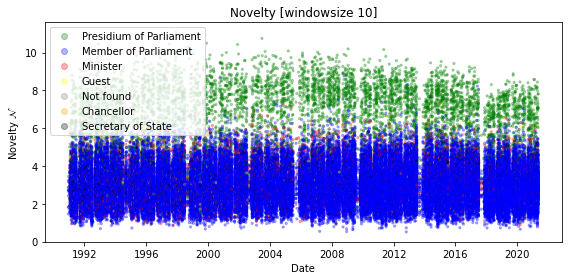

In [13]:
fig, ax1 = plt.subplots(1, 1)
plt.rcParams["figure.figsize"] = (5, 4)
#fig.set_size_inches(16.5, 8.5, forward=True)
fig.set_size_inches(8, 4, forward=True)

#select windowsize
window = 10

years = []
keys_sorted = sorted([int(key) for key in speech2KL[str(window)].keys()])
#tick_list = [0, 20000, 40000, 60000, 80000, 100000, 120000]#, 150000, 175000, 200000] #, 225000, 250000, 275000]
#for ID in [0, 20000, 40000, 60000, 80000, 100000, 120000]: #, 150000, 175000, -1]: 
#    years.append(id2rede_filtered[str(keys_sorted[ID])]["date"][:7])


for ax, num in zip([ax1], [window]): 
    
    #id2novelty = {}
    novelty = []
    role = []
    date = []
    #for key in speech2KL[num].keys(): 
        #id2novelty[key] = speech2KL[col][key]["novelty"]  
        
    keys_sorted = sorted([int(key) for key in speech2KL[str(num)].keys()])
    
    for key in keys_sorted:      
        novelty.append(speech2KL[str(num)][str(key)]["novelty"])
        role.append(id2rede_filtered[str(key)]["positionShort"])
        date.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d"))
        
    #xvalues = range(0, len(novelty), 1)
    xvalues = date
    color_map = {'Presidium of Parliament': "green", 'Member of Parliament': "blue", 'Minister': "red",
       'Guest': "yellow", 'Not found': "grey", 'Chancellor': "orange", 'Secretary of State': "black"}

    #ax.plot(pd.Series(transience), marker = "o", linewidth = 0, alpha = 0.3)
    #ax.plot(pd.Series(transience), c=pd.DataFrame(role)[0].map(color_map), marker = "o", linewidth = 0, alpha = 0.3)#
    ax.scatter(xvalues, pd.Series(novelty), c=pd.DataFrame(role)[0].map(color_map), marker = "o", alpha = 0.3, s = 5)#, s=5)
    #ax.set_xticks(tick_list)
    #ax.set_ylim(1, 2)
    #ax.set_xticklabels(years)
    ax.set_title(f'Novelty [windowsize {str(num)}]')
    ax.set_ylabel('Novelty $\mathcal{N}}$')
    ax.set_xlabel('Date')

    
    markers = [plt.Line2D([0,0],[0,0], color=color, marker='o', linestyle='', alpha = 0.3) for color in color_map.values()]
    plt.legend(markers, color_map.keys(), numpoints=1)
    
    fig.tight_layout()

annotated_ones = []
#for i, txt in enumerate(keys_sorted):
#    if novelty[i] >= 1.6:
#        annotated_ones.append(txt)
#        ax.annotate(str(txt), (xvalues[i], novelty[i]), clip_on=True)

    
#plt.savefig("./figures/novelty_by_roles_w_10.png", dpi=300, facecolor='w', 
#            edgecolor='w', orientation='portrait', format=None, 
#            transparent=False, pad_inches=0.1)

In [110]:
years = []
keys_sorted = sorted([int(key) for key in speech2KL[num].keys()])
for ID in [0, 20000, 40000, 60000, 80000, 100000, 120000]: #, 200000]: #, -1]: 
    years.append(id2rede_filtered[str(keys_sorted[ID])]["date"][:7])
years

['1990-12', '1996-09', '2002-05', '2008-03', '2012-09', '2017-04', '2021-03']

In [111]:
id2rede_filtered[str(keys_sorted[ID])]["date"]

'2021-03-05'

In [112]:
id2rede_filtered[str(keys_sorted[ID])].keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow', 'filtered_no', 'theta_array'])

In [113]:
PolID2info['11002190']["PARTY"]#.keys()

'FDP'

In [114]:
unique_parties = []
for key in PolID2info.keys():
    try: 
        unique_parties.append(PolID2info[key]["PARTY"])
    except KeyError: 
        unique_parties.append("UNK")
unique_parties = pd.Series(unique_parties).unique()
unique_parties

array(['FDP', 'SPD', 'AfD', 'DIE LINKE.', 'CDU', 'BÜNDNIS 90/DIE GRÜNEN',
       'UNK', 'CSU', 'Plos', 'PDS', 'PDS/LL'], dtype=object)

In [115]:
id2rede_filtered_party = {}

# Roles: 'Presidium of Parliament', 'Member of Parliament', 'Minister', 'Guest', 'Not found', 'Chancellor', 'Secretary of State'

for key in id2rede_filtered.keys():
    try:
        party = PolID2info[id2rede_filtered[key]["politicianId"]]["PARTY"]
    except KeyError:  
        party = "UNK"
    if party not in ["UNK"]: 
        id2rede_filtered_party[key] = id2rede_filtered[key]

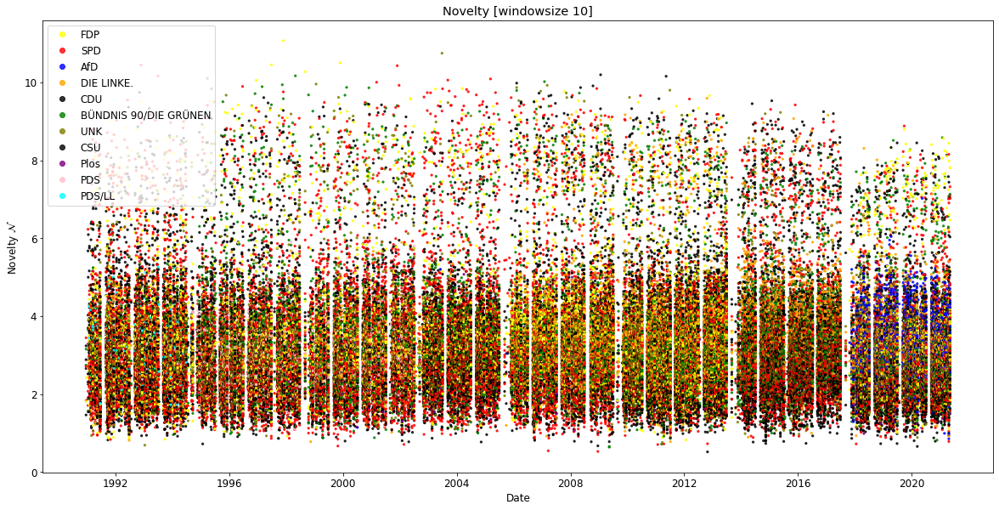

In [116]:
fig, ax1 = plt.subplots(1, 1)
plt.rcParams["figure.figsize"] = (10, 8)
fig.set_size_inches(16.5, 8.5, forward=True)

#select windowsize
window = 10

years = []
keys_sorted = sorted([int(key) for key in speech2KL[window].keys()])
#tick_list = [0, 20000, 40000, 60000, 80000, 100000, 120000]#, 150000, 175000, 200000] #, 225000, 250000, 275000]
#for ID in [0, 20000, 40000, 60000, 80000, 100000, 120000]: #, 150000, 175000, -1]: 
#    years.append(id2rede_filtered[str(keys_sorted[ID])]["date"][:7])


for ax, num in zip([ax1], [window]): 
    
    #id2novelty = {}
    novelty = []
    party = []
    date = []
    #for key in speech2KL[num].keys(): 
        #id2novelty[key] = speech2KL[col][key]["novelty"]  
        
    keys_sorted = sorted([int(key) for key in speech2KL[num].keys()])
    
    for key in keys_sorted:      
        novelty.append(speech2KL[num][str(key)]["novelty"])
        date.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d"))
        
        try: 
            party.append(PolID2info[id2rede_filtered_party[str(key)]["politicianId"]]["PARTY"])
        except KeyError:  
            party.append("UNK")
        
        
    #xvalues = range(0, len(novelty), 1)
    xvalues = date
    color_map = {'FDP': "yellow", 'SPD': "red", 'AfD': "blue", 'DIE LINKE.': "orange", 'CDU':"black", 'BÜNDNIS 90/DIE GRÜNEN':"green",
                 'UNK': "olive", 'CSU': "black", 'Plos' : "purple", 'PDS' : "pink", 'PDS/LL':"cyan"}

    #ax.plot(pd.Series(transience), marker = "o", linewidth = 0, alpha = 0.3)
    #ax.plot(pd.Series(transience), c=pd.DataFrame(role)[0].map(color_map), marker = "o", linewidth = 0, alpha = 0.3)#
    ax.scatter(xvalues, pd.Series(novelty), c=pd.DataFrame(party)[0].map(color_map), marker = "o", alpha = 0.8, s = 5)#, s=5)
    #ax.set_xticks(tick_list)
    #ax.set_ylim(1, 2)
    #ax.set_xticklabels(years)
    ax.set_title(f'Novelty [windowsize {str(num)}]')
    ax.set_ylabel('Novelty $\mathcal{N}}$')
    ax.set_xlabel('Date')

    
    markers = [plt.Line2D([0,0],[0,0], color=color, marker='o', linestyle='', alpha = 0.8) for color in color_map.values()]
    plt.legend(markers, color_map.keys(), numpoints=1)
    
    fig.tight_layout()

annotated_ones = []
#for i, txt in enumerate(keys_sorted):
#    if novelty[i] >= 1.6:
#        annotated_ones.append(txt)
#        ax.annotate(str(txt), (xvalues[i], novelty[i]), clip_on=True)

    
plt.savefig("./figures/novelty_by_party_w_10.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

In [117]:
PolID2info[id2rede_filtered['471526']["politicianId"]]["PARTY"]

'SPD'

In [77]:
id2rede_filtered_roles = {}

# Roles: 'Presidium of Parliament', 'Member of Parliament', 'Minister', 'Guest', 'Not found', 'Chancellor', 'Secretary of State'

for key in id2rede_filtered.keys():
    position = id2rede_filtered[key]["positionShort"]
    if position in ['Member of Parliament', 'Minister', 'Guest', 'Chancellor', 'Secretary of State']: 
        id2rede_filtered_roles[key] = id2rede_filtered[key]

In [79]:
keys_sorted_id2re = sorted([int(key) for key in id2rede_filtered_roles.keys()])
keys_sorted_s2kl = sorted([int(key) for key in speech2KL["10"].keys()])

len(keys_sorted_id2re), len(keys_sorted_s2kl)

(114392, 121376)

In [120]:
#1060925
#speech2KL[10]["1060925"]

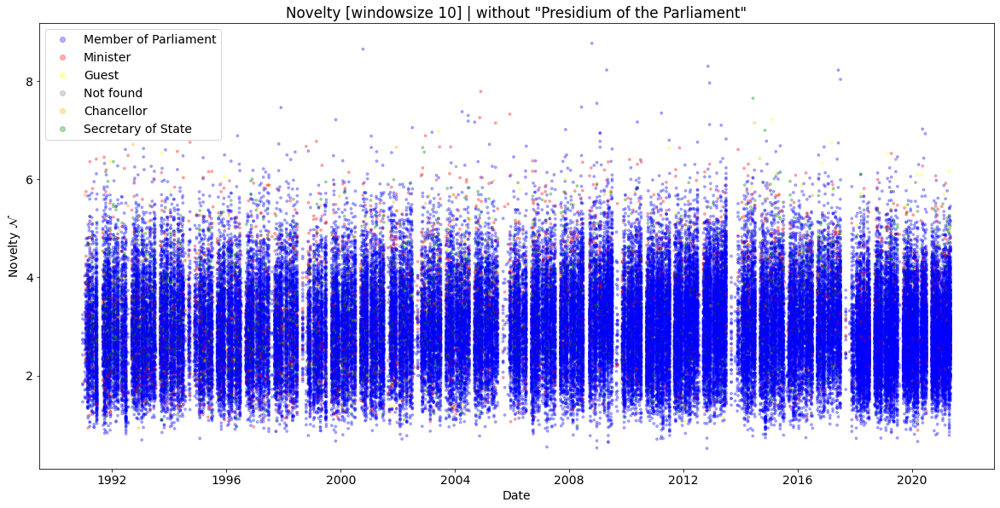

In [192]:
fig, ax1 = plt.subplots(1, 1)
plt.rcParams["figure.figsize"] = (10, 8)
fig.set_size_inches(16.5, 8.5, forward=True)

#select windowsize
window = 10

years = []
keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
tick_list = [0, 20000, 40000, 60000, 80000, 100000, 120000]#, 150000, 175000, 200000] #, 225000, 250000, 275000]
#for ID in [0, 20000, 40000, 60000, 80000, 100000, 120000]: #, 150000, 175000, -1]: 
#    years.append(id2rede_filtered_roles[str(keys_sorted[ID])]["date"][:7])


for ax, num in zip([ax1], [window]): 
    
    #id2novelty = {}
    novelty = []
    role = []
    date = []
    #for key in speech2KL[num].keys(): 
        #id2novelty[key] = speech2KL[col][key]["novelty"]  
        
    keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
    keys_speech2KL = sorted([int(key) for key in speech2KL[10].keys()]) 
    
    for key in keys_sorted: 
        try:      
            novelty.append(speech2KL[num][str(key)]["novelty"])
            role.append(id2rede_filtered[str(key)]["positionShort"])
            date.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d"))
        except KeyError: 
            pass
        
    #xvalues = range(0, len(novelty), 1)
    xvalues = date
    color_map = {'Member of Parliament': "blue", 'Minister': "red",
       'Guest': "yellow", 'Not found': "grey", 'Chancellor': "orange", 'Secretary of State': "green"}

    #ax.plot(pd.Series(transience), marker = "o", linewidth = 0, alpha = 0.3)
    #ax.plot(pd.Series(transience), c=pd.DataFrame(role)[0].map(color_map), marker = "o", linewidth = 0, alpha = 0.3)#
    ax.scatter(xvalues, pd.Series(novelty), c=pd.DataFrame(role)[0].map(color_map), marker = "o", alpha = 0.3, s = 8)#, s=5)
    #ax.set_xticks(tick_list)
    #ax.set_ylim(1, 2)
    #ax.set_xticklabels(years)
    ax.set_title(f'Novelty [windowsize {str(num)}] | without "Presidium of the Parliament"')
    ax.set_ylabel('Novelty $\mathcal{N}}$')
    ax.set_xlabel('Date')

    
    markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='', alpha = 0.3) for color in color_map.values()]
    plt.legend(markers, color_map.keys(), numpoints=1)
    
    fig.tight_layout()

annotated_ones = []
#for i, txt in enumerate(keys_sorted):
#    if novelty[i] >= 1.6:
#        annotated_ones.append(txt)
#        ax.annotate(str(txt), (xvalues[i], novelty[i]), clip_on=True)

    
plt.savefig("./figures/novelty_by_roles_w_10_without_presidium.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

In [122]:
day2id2rede_filtered['2017-10-24'].keys()

dict_keys(['1000017', '1000002', '1000004', '1000006', '1000008', '1000010', '1000012', '1000013', '1000033'])

In [123]:
#[date for date in dates_unique]

In [124]:
id2rede_filtered["563027"].keys()#["date"].split("-")[0]

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow', 'filtered_no', 'theta_array'])

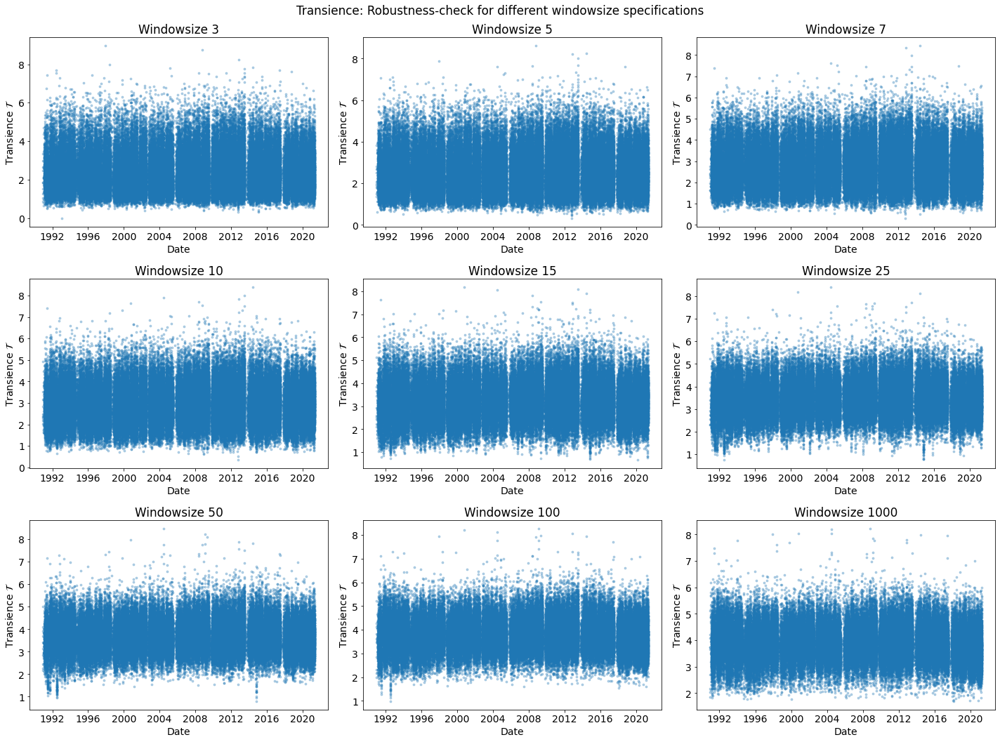

In [191]:
plt.rcParams["figure.figsize"] = (20, 15)
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3)
fig.suptitle('Transience: Robustness-check for different windowsize specifications')

#[1, 3, 5, 7, 10, 15, 20]

for ax, num in zip([ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9], [3, 5, 7, 10, 15, 25, 50, 100, 1000]): #[5, 15, 25, 35, 45, 55, 65, 75, 95]): 
    
    #id2novelty = {}
    transience = []
    date = []
    #for key in speech2KL[num].keys(): 
        #id2novelty[key] = speech2KL[col][key]["novelty"]  
        
    #keys_sorted = sorted([int(key) for key in speech2KL[num].keys()])
    keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
    
    #for key in keys_sorted:      
     #   transience.append(speech2KL[num][str(key)]["transience"])
        
    for key in keys_sorted: 
        try:      
            transience.append(speech2KL[num][str(key)]["transience"])
            #role.append(id2rede_filtered[str(key)]["positionShort"])
            date.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d"))
        except KeyError: 
            pass

    xvalues = date
    #ax.plot(pd.Series(transience), marker = "o", linewidth = 0, alpha = 0.3)
    ax.scatter(xvalues, pd.Series(transience), marker = "o", alpha = 0.3, s = 8)#, s=5)
    
    #years = []
    #for ID in [0, 20000, 40000, 60000, 80000, 100000, 120000]: 
        #years.append(id2rede_filtered[str(keys_sorted[ID])]["date"][:7])

    #ax.set_xticks([0, 20000, 40000, 60000, 80000, 100000, 120000])
    #ax.set_xticklabels(years)
    ax.set_title(f'Windowsize {str(num)}')
    ax.set_ylabel('Transience $\mathcal{T}}$')
    ax.set_xlabel('Date')
    fig.tight_layout()
    
plt.savefig("./figures/transience_robustness_different_windows.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

In [126]:
#data_ready[1]

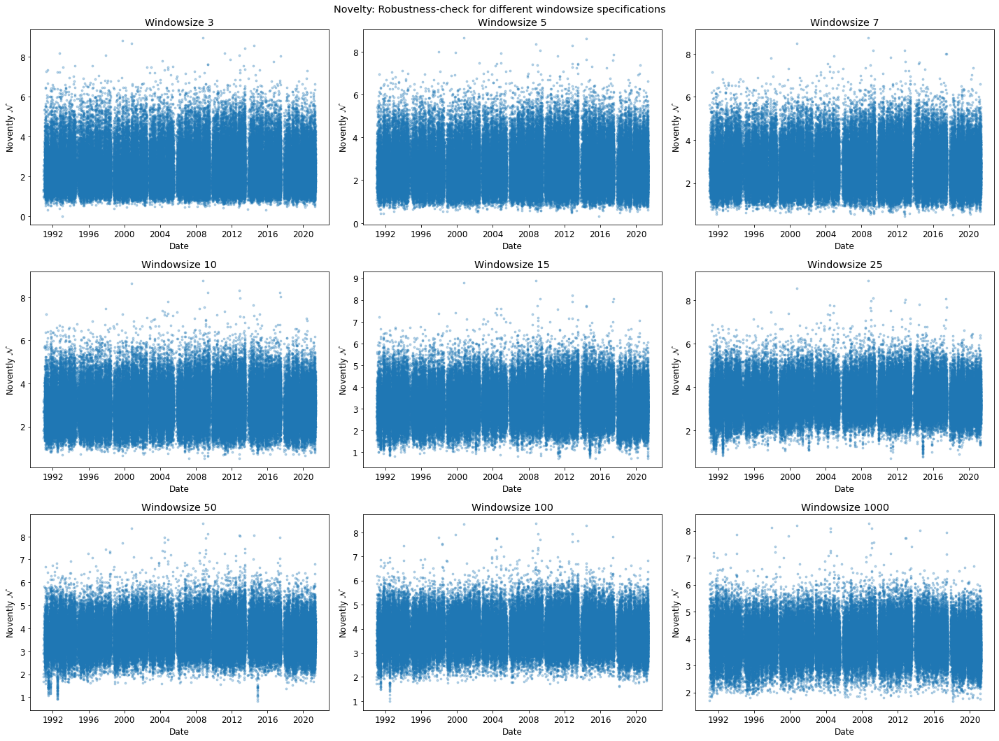

In [88]:
plt.rcParams["figure.figsize"] = (20, 15)
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3)
fig.suptitle('Novelty: Robustness-check for different windowsize specifications')


for ax, num in zip([ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9], [3, 5, 7, 10, 15, 25, 50, 100, 1000]): #[5, 15, 25, 35, 45, 55, 65, 75, 95]): 
    
    novelty = []
    date = []
  
    #keys_sorted = sorted([int(key) for key in speech2KL[num].keys()])
    
    #for key in keys_sorted:      
    #    novelty.append(speech2KL[num][str(key)]["novelty"])

    #ax.plot(pd.Series(novelty), marker = "o", linewidth = 0, alpha = 0.3)
    
    
    #keys_sorted = sorted([int(key) for key in speech2KL[num].keys()])
    keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
    
    #for key in keys_sorted:      
     #   transience.append(speech2KL[num][str(key)]["transience"])
        
    for key in keys_sorted: 
        try:      
            novelty.append(speech2KL[str(num)][str(key)]["novelty"])
            #role.append(id2rede_filtered[str(key)]["positionShort"])
            date.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d"))
        except KeyError: 
            pass

    xvalues = date
    #ax.plot(pd.Series(transience), marker = "o", linewidth = 0, alpha = 0.3)
    ax.scatter(xvalues, pd.Series(novelty), marker = "o", alpha = 0.3, s = 8)#, s=5)
    

    
    #years = []
    #for ID in [0, 50000, 100000, 150000, 200000, -1]: 
    #    years.append(id2rede_filtered[str(keys_sorted[ID])]["date"][:7])
    #ax.set_xticks([0, 50000, 100000, 150000, 200000, 250000])
    #ax.set_xticklabels(years)
    ax.set_title(f'Windowsize {str(num)}')
    ax.set_ylabel('Novently $\mathcal{N}}$')
    ax.set_xlabel('Date')
    fig.tight_layout()
    
plt.savefig("./figures/novelty_robustness_different_windows.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

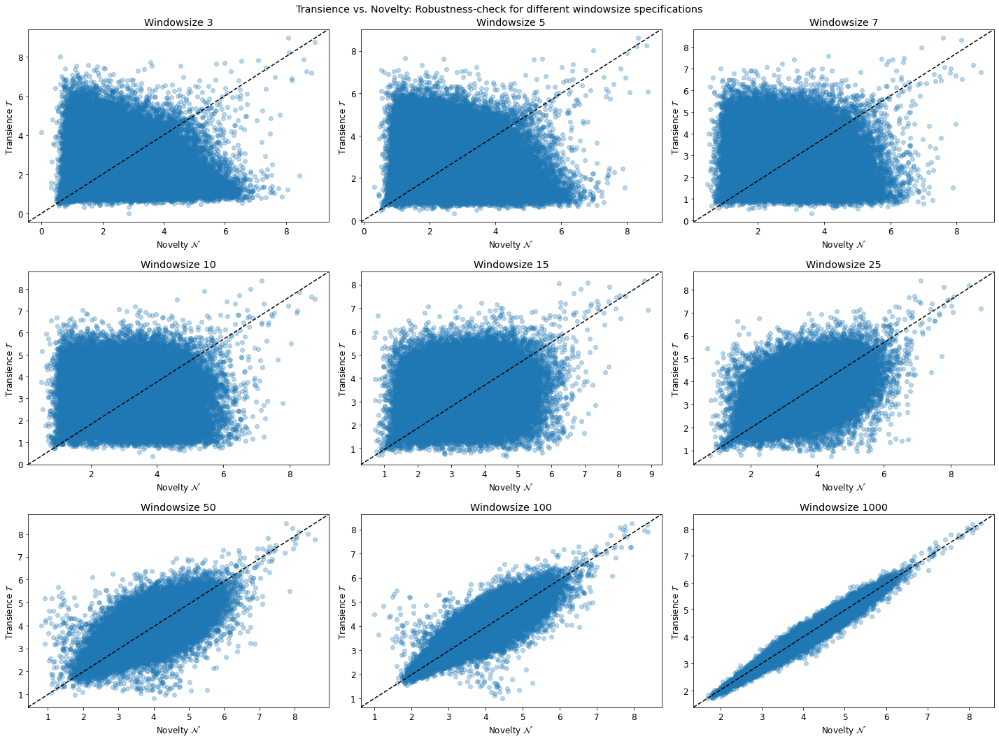

In [89]:
plt.rcParams["figure.figsize"] = (20, 15)
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3)
fig.suptitle('Transience vs. Novelty: Robustness-check for different windowsize specifications')

#[1, 3, 5, 7, 10, 15, 20]

for ax, num in zip([ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9], [3, 5, 7, 10, 15, 25, 50, 100, 1000]):#[3, 5, 7, 10, 15, 20, 25, 35, 50]): #[5, 15, 25, 35, 45, 55, 65, 75, 95]): 
    
    #id2novelty = {}
    transience = []
    novelty = []
    #for key in speech2KL[num].keys(): 
        #id2novelty[key] = speech2KL[col][key]["novelty"]
           
    keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
    
    #for key in keys_sorted: 
    #    transience.append(speech2KL[num][str(key)]["transience"])
    #    novelty.append(speech2KL[num][str(key)]["novelty"])
        
    for key in keys_sorted: 
        try:      
            novelty.append(speech2KL[str(num)][str(key)]["novelty"])
            transience.append(speech2KL[str(num)][str(key)]["transience"])
        except KeyError: 
            pass
        
    #ax.set_xlim(0, 5)
    #ax.set_ylim(0, 5)

    ax.plot(novelty, transience, marker = "o", linewidth = 0, alpha = 0.3)
    ax.plot([0,1],[0,1], linestyle='--', color='k', transform=ax.transAxes)
    
    ax.set_title(f'Windowsize {str(num)}')
    ax.set_ylabel('Transience $\mathcal{T}}$')
    ax.set_xlabel('Novelty $\mathcal{N}$')
    fig.tight_layout()

    ax.set_title(f'Windowsize {str(num)}')
    
plt.savefig("./figures/TransVsNovelty_robustness_different_windows.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

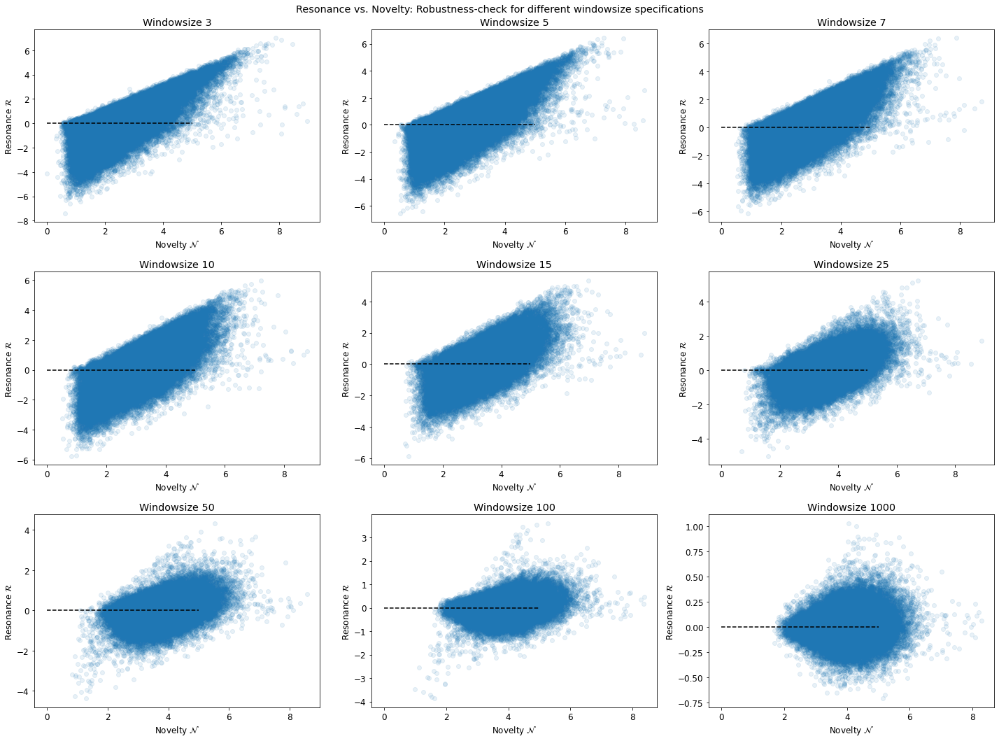

In [91]:
plt.rcParams["figure.figsize"] = (20, 15)
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3)
fig.suptitle('Resonance vs. Novelty: Robustness-check for different windowsize specifications')

for ax, num in zip([ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9], [3, 5, 7, 10, 15, 25, 50, 100, 1000]):# [3, 5, 7, 10, 15, 20, 25, 35, 50]): 
    
    #id2novelty = {}
    resonance = []
    novelty = []
    #for key in speech2KL[num].keys(): 
        #id2novelty[key] = speech2KL[col][key]["novelty"]
           
    keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
    
    #for key in keys_sorted: 
    #    resonance.append(speech2KL[num][str(key)]["resonance"])
    #    novelty.append(speech2KL[num][str(key)]["novelty"])
        
    for key in keys_sorted: 
        try:      
            novelty.append(speech2KL[str(num)][str(key)]["novelty"])
            resonance.append(speech2KL[str(num)][str(key)]["resonance"])
        except KeyError: 
            pass
        
    #ax.set_xlim(-1, 5)
    #ax.set_ylim(-2, 2)

    ax.plot(novelty, resonance, marker = "o", linewidth = 0, alpha = 0.1)
    ax.set_title(f'Windowsize {str(num)}')
    ax.set_ylabel('Resonance $\mathcal{R}}$')
    ax.set_xlabel('Novelty $\mathcal{N}$')
    fig.tight_layout()
    
    ax.hlines(y=0, xmin = -0, xmax = 5, linestyle='--', color='k', zorder=3)

    
plt.savefig("./figures/ResonanceVsNovelty_robustness_different_windows.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

In [109]:
# Save everything in one variable: it's "keys_sorted, novelty, transience, resonance"
window = "25"

resonance = []
novelty = []
transience = []
         
keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])
    
for key in keys_sorted: 
    if str(key) in speech2KL[window].keys():
        resonance.append(speech2KL[window][str(key)]["resonance"])
        novelty.append(speech2KL[window][str(key)]["novelty"])
        transience.append(speech2KL[window][str(key)]["transience"])

stacked_data = np.vstack(zip(keys_sorted, novelty, transience, resonance))

<ipython-input-109-b8bbb38ae771>:16: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  stacked_data = np.vstack(zip(keys_sorted, novelty, transience, resonance))


In [103]:
type(stacked_data), keys_sorted[0], len(stacked_data), len(keys_sorted), len(novelty), len(transience)

(numpy.ndarray, 471527, 114371, 114392, 114371, 114371)

In [104]:
stacked_data[:10]

array([[ 4.71527000e+05,  2.55304693e+00,  2.70748443e+00,
        -1.54437500e-01],
       [ 4.71532000e+05,  2.86487828e+00,  2.79888555e+00,
         6.59927260e-02],
       [ 4.71536000e+05,  3.00851231e+00,  3.14183092e+00,
        -1.33318613e-01],
       [ 4.71538000e+05,  3.66381160e+00,  3.70235824e+00,
        -3.85466372e-02],
       [ 4.71540000e+05,  3.23929628e+00,  3.97787897e+00,
        -7.38582692e-01],
       [ 4.71542000e+05,  2.81889141e+00,  3.70514858e+00,
        -8.86257165e-01],
       [ 4.71544000e+05,  3.75573450e+00,  5.08794706e+00,
        -1.33221255e+00],
       [ 4.71547000e+05,  2.01442393e+00,  2.33061270e+00,
        -3.16188772e-01],
       [ 4.71549000e+05,  2.06481253e+00,  2.55406302e+00,
        -4.89250490e-01],
       [ 4.71551000e+05,  1.61487899e+00,  2.31277707e+00,
        -6.97898085e-01]])

In [133]:
#speech2KL[num][str(471526)]["novelty"], speech2KL[num][str(471526)]["transience"], speech2KL[num][str(471526)]["resonance"]

In [134]:
#stacked_data[:,0] #, len(novelty) #249166

In [ ]:
from sklearn.linear_model import LinearRegression

In [146]:
window = 25
novelty = []
time = []
date = []
ID = []
name = []
transience = []
resonance = []
positionShort = []
politicianId = []
firstName = []
lastName = []
electoralTerm = []

keys_sorted = sorted([int(key) for key in id2rede_filtered_roles.keys()])

for key in keys_sorted:   
    role_spec = id2rede_filtered_roles[str(key)]["positionShort"]
    # 'Presidium of Parliament' is excluded
    if role_spec in ['Member of Parliament', 'Minister', 'Secretary of State', 'Guest', 'Chancellor'] and str(key) in speech2KL[str(25)].keys(): #['Member of Parliament', 'Minister', 'Guest', 'Secretary of State']
        novelty.append(speech2KL[str(window)][str(key)]["novelty"])
        transience.append(speech2KL[str(window)][str(key)]["transience"])
        resonance.append(speech2KL[str(window)][str(key)]["resonance"])
        time.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d").timestamp())
        date.append(datetime.strptime(id2rede_filtered[str(key)]["date"], "%Y-%m-%d"))
        ID.append(key)
        name.append(id2rede_filtered[str(key)]["name"])
        firstName.append(id2rede_filtered[str(key)]["firstName"])
        lastName.append(id2rede_filtered[str(key)]["lastName"])
        positionShort.append(id2rede_filtered[str(key)]["positionShort"])
        politicianId.append(id2rede_filtered[str(key)]["politicianId"])
        electoralTerm.append(id2rede_filtered[str(key)]["electoralTerm"])

In [147]:
df = pd.DataFrame()
df["novelty"] = pd.Series(novelty)
df["transience"] = pd.Series(transience)
df["resonance"] = pd.Series(resonance)
df["date"] = date
df["time"] = time
df["ID"] = ID
df["name"] = name
df["positionShort"] = positionShort
df["politicianId"] = politicianId
df["electoralTerm"] = electoralTerm
df["firstName"] = firstName
df["lastName"] = lastName

df.head()

,novelty,transience,resonance,date,time,ID,name,positionShort,politicianId,electoralTerm,firstName,lastName
0,2.543760,2.741927,-0.198167,1990-12-20,661647600.0,471527,dregger,Member of Parliament,11000418,12,,dregger
1,2.763482,2.940083,-0.176601,1990-12-20,661647600.0,471532,ullmann,Member of Parliament,11002354,12,,ullmann
2,2.930437,3.379248,-0.448811,1990-12-20,661647600.0,471536,heuer,Member of Parliament,11000891,12,,heuer
3,3.534959,3.911209,-0.376250,1990-12-20,661647600.0,471538,bohl,Member of Parliament,11000230,12,,bohl
4,3.151680,4.161738,-1.010058,1990-12-20,661647600.0,471540,struck,Member of Parliament,11002278,12,,struck


In [105]:
def plot_quants_2Dhist(q0, q1, ax, xbins, ybins, make_cbar=True,
                       cbar_axis=False, cbar_orientation='vertical', colorvmax=None):
    
    q0bins = xbins
    q1bins = ybins
    
    H, xedges, yedges = np.histogram2d(q0, q1, bins=[q0bins, q1bins])

    # H needs to be rotated and flipped
    H = np.rot90(H)
    H = np.flipud(H)

    # Mask zeros
    Hmasked = np.ma.masked_where(H==0,H) # Mask pixels with a value
    
    # Plot 2D histogram using pcolor
    if colorvmax:
        usemax = colorvmax
    else:
        usemax = H.max()
    pcolm = ax.pcolormesh(xedges,yedges,Hmasked, norm=mpl.colors.LogNorm(vmin=1, vmax=usemax))
    
    if make_cbar:
        if cbar_axis:
            cbar = fig.colorbar(pcolm, cax=cbar_axis, orientation=cbar_orientation)  
        else:
            cbar = fig.colorbar(pcolm, ax=ax, orientation=cbar_orientation)
        cbar.ax.set_ylabel('counts')
    
    #ax.set_xlabel(quants[0])
    #ax.set_ylabel(quants[1])
    
    if make_cbar:
        return H, cbar
    else:
        return H
    
centininch = 2.54
inchincent = .3937

def centtoinch(cents):
    return .3937*cents

def inchtocent(inches):
    return 2.54*inches

<Figure size 576x252 with 0 Axes>

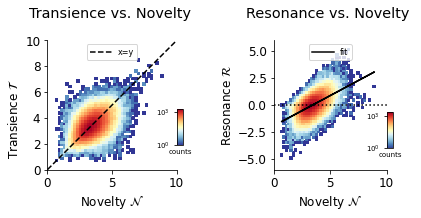

In [176]:
figsize = (centtoinch(11.4), 2.5)
#plt.set_cmap(plt.cm.jet)
#plt.set_cmap('viridis')
plt.set_cmap('RdYlBu_r')


fig = plt.figure(figsize=figsize)

# Uncomment to see figure extent.
#ax = fig.add_axes([0., 0., 1., 1.])

## Plot Transience v. Novelty

q0 = stacked_data[:,1] #novelty
q1 = stacked_data[:,2] #transience

ax = fig.add_axes([0.1, 0.15, 0.4, 0.72])

cbaxes = fig.add_axes([0.5, 0.29, 0.02, 0.2])


xbins = np.linspace(0, 10, 50) # determines size and granularity of the plot
ybins = np.linspace(0, 10, 50)

H, cbar = plot_quants_2Dhist(q0, q1, ax, xbins, ybins,
                             make_cbar=True, cbar_axis=cbaxes, cbar_orientation='vertical')
cbar.ax.set_ylabel('')
cbar.ax.set_xlabel('counts', fontsize=7)
cbar.ax.xaxis.set_label_position('bottom')
cbar.ax.yaxis.set_ticks_position('left')
cbar.ax.tick_params(labelsize=7)

### Identity (x=y) line
#ax.plot([0, 9.5], [0, 9.5], 'k--', linewidth=1.5)
ax.plot([0,1],[0,1], linestyle='--', color='k', transform=ax.transAxes)

ax.legend([mpl.lines.Line2D([0], [0], color='k', linewidth=1.5, linestyle='--')],
          ['x=y'],
          loc='upper center', fontsize=8, ncol=2, handlelength=2.7)

ax.set_ylabel('Transience $\mathcal{T}$         ')
ax.set_xlabel('Novelty $\mathcal{N}$')

ax.set_title('Transience vs. Novelty \n')

ax.set_aspect('equal')

### Hide the right and top spines.
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
### Show ticks only on the left and bottom spines.
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

# Limit spine range
#ax.spines['left'].set_bounds( 0, 8)
#ax.set_yticks([0, 2, 4, 6, 8])
#ax.spines['bottom'].set_bounds( 0, 10)
#ax.set_xticks([0, 2, 4, 6, 8, 10])




## Plot Reson v. Novelty

ax = fig.add_axes([0.8, 0.15, 0.35, 0.72])

cbaxes = fig.add_axes([1.15, 0.27, 0.02, 0.2])

#quants = ['Novelty', 'Resonance']

q0 = stacked_data[:,1] #novelty
q2 = stacked_data[:,3] #transience

xbins = np.linspace(0, 10, 50)
ybins = np.linspace(-6, 6, 50)

H, cbar = plot_quants_2Dhist(q0, q2, ax, xbins, ybins,
                             make_cbar=True, cbar_axis=cbaxes, cbar_orientation='vertical')
cbar.ax.set_ylabel('')
cbar.ax.set_xlabel('counts', fontsize=7)
cbar.ax.xaxis.set_label_position('bottom')
cbar.ax.yaxis.set_ticks_position('left')
cbar.ax.tick_params(labelsize=7)

ax.axhline(color='k', linewidth=1.5, linestyle=':')

#ax.set_xlim(-1, 10)
#ax.set_ylim(-7, 8)

### Hide the right and top spines.
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

### Show ticks only on the left and bottom spines.
#ax.yaxis.set_ticks_position('left')
#ax.xaxis.set_ticks_position('bottom')

### Limit spine range
#ax.spines['left'].set_bounds( -5, 5)
#ax.set_yticks([-5, 0, 5])
#ax.spines['bottom'].set_bounds( 0, 10)
#ax.set_xticks([ 0, 2, 4, 6, 8, 10])

ax.set_ylabel('Resonance $\mathcal{R}}$')
ax.set_xlabel('Novelty $\mathcal{N}$')

_ = ax.set_title('Resonance vs. Novelty \n')



df_res_vs_novel = df.dropna(subset=['novelty'])
df_res_vs_novel = df_res_vs_novel.dropna(subset=["resonance"])
novelty_df = np.array(df_res_vs_novel["novelty"]).reshape(-1, 1) 
resonance_df = np.array(df_res_vs_novel["resonance"]).reshape(-1, 1) 
linear_regressor = LinearRegression()  # create object for the class
linear_regressor.fit(novelty_df, resonance_df)  # perform linear regression
Y_pred = linear_regressor.predict(novelty_df)  # make predictions
#plt.hlines(y=0, xmin = -0, xmax = 8, linestyle='--', color='k', zorder=3)
#plt.plot(novelty, Y_pred, color='red', linewidth = 2)

ax.plot(list(novelty_df), list(Y_pred), linestyle='-', color='k')

ax.legend([mpl.lines.Line2D(list(novelty_df), list(Y_pred), color='k', linewidth=1.5, linestyle='-')],
          ['fit'],
          loc='upper center', fontsize=8, ncol=2, handlelength=2.7)






#fig.tight_layout()

plt.savefig("./figures/TransVsNov_ResVsNovel_combi_neu.png", dpi=300, facecolor='w', 
            edgecolor='w', format=None, bbox_inches='tight',
            transparent=False, pad_inches=0.1)

In [178]:
linear_regressor.coef_

array([[0.56069394]])

In [149]:
df_res_vs_novel.to_csv("../../data/written/nov_res_trans_df_naive_window25.csv")

In [137]:
# other try
#a = novelty
#b = transience

#plt.hist2d(a, b, (500, 500), cmap=plt.cm.jet)
#plt.colorbar()

### look only at data with high novelty

In [138]:
len(id2rede_filtered), len(speech2KL[10])

(121387, 121376)

In [139]:
keys_sorted = sorted([int(key) for key in speech2KL[10].keys()])

In [117]:
novel2info = copy.deepcopy(id2rede_filtered)

In [141]:
len(novel2info), len(id2rede_filtered)

(121387, 121387)

In [119]:
#empty_d = {}
#novel2info = copy.deepcopy(empty_d)

keys_to_del = []
for key in novel2info.keys(): 
    if key not in list(speech2KL[str(25)].keys()) or speech2KL[str(25)][key]["novelty"] < 0:
        keys_to_del.append(key)
    else: 
        novel2info[key]["novelty"] = speech2KL[str(25)][key]["novelty"]
        
print(len(keys_to_del))

#for key in novel2info.keys():
#    del novel2info[key]
    
#for key in keys_sorted: 
#    if speech2KL[10][str(key)]["novelty"] > 0:
#        novel2info1[str(key)] = id2rede_filtered[str(key)]
#        novel2info1[str(key)]["novelty"] = speech2KL[10][str(key)]["novelty"]

26


In [127]:
#keys_to_del

In [126]:
#speech2KL[str(25)][keys_to_del[6]]["novelty"]

In [128]:
for key in keys_to_del:
    del novel2info[key]

In [144]:
#novel2info[keys_to_del[1]]

In [129]:
novel_keys = list(novel2info.keys())
id2rede_filtered[novel_keys[1]].keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow', 'filtered_no', 'theta_array'])

In [146]:
nk = 6
#novel2info[novel_keys[nk]]["novelty"], novel2info[novel_keys[nk]]["positionShort"], novel2info[novel_keys[nk]]["concatSpeech"]

In [130]:
role = []
for key in novel2info.keys(): 
    role.append(novel2info[key]["positionShort"])

In [148]:
pd.Series(role).value_counts()

Member of Parliament       103650
Presidium of Parliament      6980
Secretary of State           4973
Minister                     4268
Guest                        1086
Chancellor                    404
Not found                      15
dtype: int64

In [131]:
speech2KL.keys(), pd.Series(role).unique()

(dict_keys(['1', '3', '5', '7', '10', '15', '20', '25', '30', '35', '40', '45', '50', '55', '60', '65', '70', '75', '80', '85', '90', '95', '100', '500', '1000']),
 array(['Presidium of Parliament', 'Member of Parliament', 'Minister',
        'Secretary of State', 'Guest', 'Chancellor', 'Not found'],
       dtype=object))

In [150]:
#for i, txt in enumerate(keys_sorted):
#    if transience[i] > 1.2:
        #ax.annotate(txt, (keys_sorted[i], transience[i]), clip_on=True)
#        print(str(txt))

In [151]:
#pattern2info = {}
#for key in keys_sorted: 
#    if speech2KL[10][str(key)]["novelty"] > 3.5:
#        pattern2info[str(key)] = id2rede_filtered[str(key)]
#        pattern2info[str(key)]["novelty"] = speech2KL[10][str(key)]["novelty"]

In [152]:
#pattern2info["488099"]["date"]#.keys()

#for key in pattern2info.keys(): 
#    print(pattern2info[key]["date"])
#del pattern2info

In [153]:
#del novel2info

In [132]:
for key in keys_sorted:
    try:
        novel2info[str(key)]["novelty"]
    except KeyError: 
        print(key)

1060882
1060884
1060886
1060888
1060892
1060894
1060898
1060902
1060906
1060908
1060914
1060921
1060923
1060925
1060927
1060931
1060933
1060935
1060941
1060943
1060945
1060947
1060955
1060957


In [155]:
novel2info["471526"].keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow', 'filtered_no', 'theta_array', 'novelty'])

121376
121376


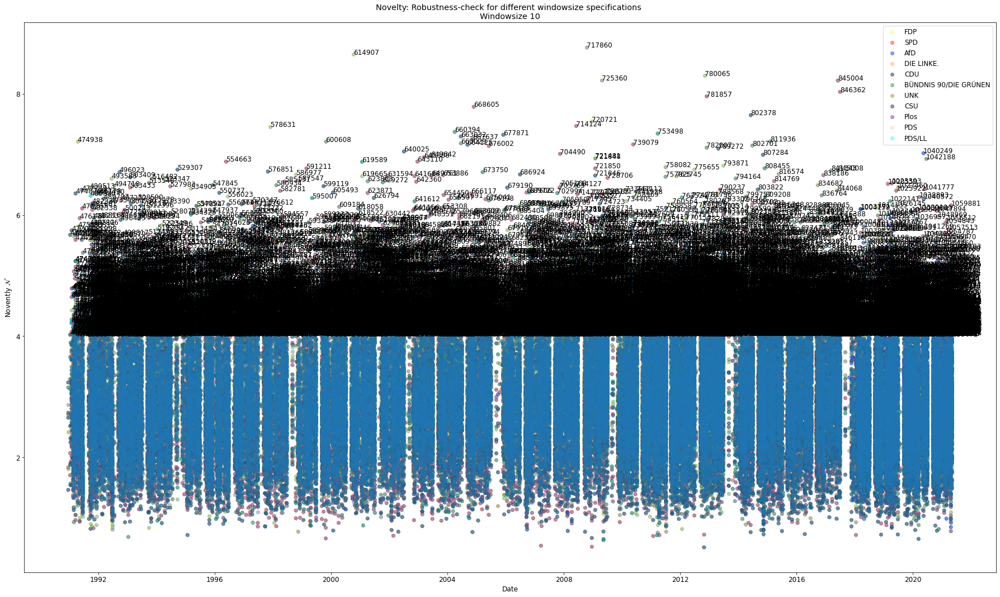

In [157]:
plt.rcParams["figure.figsize"] = (25, 15)
fig, ax = plt.subplots(1, 1)
#fig.suptitle('Novelty: Robustness-check for different windowsize specifications')


#for ax, num in zip([ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9], [3, 5, 7, 10, 15, 20, 25, 35, 50]): #[5, 15, 25, 35, 45, 55, 65, 75, 95]): 
    
novelty = []
role = []
date = []
party = []

keys_sorted = sorted([int(key) for key in novel2info.keys()])

#ROLES : 'Member of Parliament', 'Presidium of Parliament', 'Minister', 'Secretary of State', 'Guest', 'Chancellor', 'Not found'
for key in keys_sorted:   
    role_spec = novel2info[str(key)]["positionShort"]
    # 'Presidium of Parliament' is excluded
    if role_spec in ['Member of Parliament', 'Minister', 'Secretary of State', 'Guest', 'Chancellor']: #['Member of Parliament', 'Minister', 'Guest', 'Secretary of State']
        novelty.append(novel2info[str(key)]["novelty"])
        role.append(role_spec)
        date.append(datetime.strptime(novel2info[str(key)]["date"], "%Y-%m-%d"))
    #if novel2info[str(key)]["novelty"] > 0 and role_spec in ['Member of Parliament', 'Minister', 'Guest', 'Secretary of State']:
    #    novelty.append(novel2info[str(key)]["novelty"])
    #    role.append(role_spec)
    else: 
        novelty.append(np.nan)
        role.append("Not found")
        date.append(datetime.strptime(novel2info[str(key)]["date"], "%Y-%m-%d"))
        
    try: 
        party.append(PolID2info[novel2info[str(key)]["politicianId"]]["PARTY"])
    except KeyError:  
        party.append("UNK")
        

print(len(keys_sorted))
print(len(novelty))

ax.plot(date, pd.Series(novelty), marker = "o", linewidth = 0, alpha = 0.3)

#years = []
#for ID in [0, 50000, 100000, 150000, 200000, -1]: 
#    years.append(id2rede_filtered[str(keys_sorted[ID])]["date"][:7])
#ax.set_xticks([0, 50000, 100000, 150000, 200000, 250000])
#ax.set_xticklabels(years)


#xvalues = range(0, len(novelty), 1)
xvalues = date
color_map_role = {'Presidium of Parliament': "yellow", 'Member of Parliament': "blue", 'Minister': "purple",
       'Guest': "green", 'Not found': "grey", 'Chancellor': "orange", 'Secretary of State': "red"}
color_map_party = {'FDP': "yellow", 'SPD': "red", 'AfD': "blue", 'DIE LINKE.': "orange", 'CDU':"black", 'BÜNDNIS 90/DIE GRÜNEN':"green",
                 'UNK': "olive", 'CSU': "black", 'Plos' : "purple", 'PDS' : "pink", 'PDS/LL':"cyan"}

# CHANGE THESE
color_map = color_map_party
category = party

ax.scatter(xvalues, pd.Series(novelty), c=pd.DataFrame(category)[0].map(color_map), marker = "o", alpha = 0.4)#, s=5)
#ax.set_xticks(tick_list)
#ax.set_ylim(1, 2)
#ax.set_xticklabels(years)
ax.set_title(f'Novelty [windowsize 10]')
ax.set_ylabel('Novelty $\mathcal{N}}$')
ax.set_xlabel('Date')

    
markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='', alpha = 0.4) for color in color_map.values()]
plt.legend(markers, color_map.keys(), numpoints=1)


for i, txt in enumerate(keys_sorted):
    #if novelty[i] != 0 & role[i] == "Member of Parliament":
    if novelty[i] > 4:
        ax.annotate(str(txt), (xvalues[i], novelty[i]), clip_on=True)

#ax.set_ylim(3, 6) 
ax.set_title(f'Novelty: Robustness-check for different windowsize specifications \nWindowsize {str(10)}')
ax.set_ylabel('Novently $\mathcal{N}}$')
ax.set_xlabel('Date')
fig.tight_layout()

In [158]:
novel2info

{'1000017': {'concatSpeech': '  Guten Morgen, liebe Kolleginnen und Kollegen! Nehmen Sie bitte Platz.  Meine sehr verehrten Damen und Herren! Liebe Kolleginnen und Kollegen! Ich begrüße Sie zur konstituierenden Sitzung des 19. Deutschen Bundestages. Es entspricht der ständigen Übung, zu Beginn der konstituierenden Sitzung nach den Regelungen der bisherigen Geschäftsordnung des Deutschen Bundestages zu verfahren.  § 1 Absatz 2 der Geschäftsordnung des Deutschen Bundestages sieht vor, dass das am längsten dem Bundestag angehörende Mitglied, das hierzu bereit ist, den Vorsitz übernimmt, bis der Deutsche Bundestag einen Präsidenten gewählt hat.  Die Fraktion der AfD widerspricht diesem Verfahren und hat auf Drucksache 19/2 beantragt, einen Versammlungsleiter zu wählen, der die konstituierende Sitzung eröffnen soll. Über diesen Antrag lasse ich sofort abstimmen. Wer dem Antrag der Fraktion der AfD zustimmt, den bitte ich um sein Handzeichen. – Gegenstimmen? –  ({0})  Enthaltungen? – Der Ant

In [159]:
novel2info["802701"]["positionShort"]# Chancellor

'Chancellor'

In [160]:
novel2info["802701"]["novelty"]#.keys()

7.148071845114319

In [161]:
novel2info["813824"]["name"], novel2info["813824"]["positionShort"], PolID2info[novel2info["813824"]["politicianId"]]["PARTY"]#.keys()

('Angela Merkel', 'Chancellor', 'CDU')

In [162]:
novel2info["813824"]["concatSpeech"]

'13. Oktober 2014: Gespräch mit einem Vertreter der RWE AG.  Chef des Bundeskanzleramts und Bundesminister für besondere Aufgaben, Peter Altmaier: 27. März 2014: Gespräch mit einem Vertreter der Eon SE; 1. Dezember 2014: Gespräch mit Vertretern der RWE AG; 5. Dezember 2014: Gespräch mit Vertretern der Eon SE; 3. Februar 2015: Gespräch mit einem Vertreter der EnBW AG; 17. Februar 2015: Gespräch mit einem Vertreter der RWE AG; 16. März 2015: Gespräch mit einem Vertreter der Eon SE.  Staatssekretär im Bundesministerium der Finanzen, Werner Gatzer: 19. Dezember 2014: Gespräch mit Vertretern der RWE AG.  Bundesministerin für Umwelt, Naturschutz, Bau und Reaktorsicherheit, Frau Dr. Barbara Hendricks, gemeinsam mit Staatssekretär Jochen Flasbarth: 5. Dezember 2014: Gespräch mit Vertretern von Eon SE. Die Thematik der Atomrückstellungen wurde als aktueller Punkt am Rande angesprochen.  Der Bundesminister für Wirtschaft und Energie, Sigmar Gabriel, hat nachfolgend genannte Gespräche geführt, di

In [163]:
key2novel_speeches = {}
#'Chancellor': 'Secretary of State': 'Presidium of Parliament'

for key in novel2info.keys(): 
    if novel2info[key]["novelty"] > 3.5 and novel2info[key]["positionShort"] in ['Member of Parliament', 'Minister', 'Guest', 'Secretary of State']:
        key2novel_speeches[key] = novel2info[key]["concatSpeech"]
len(key2novel_speeches)

30554

In [ ]:
#len(novel2info["503383"]["concatSpeech"].split(" "))#.keys()

In [ ]:
#key2novel_speeches

### Linear Regression on data

In [164]:
datetime.strptime(novel2info[str(key)]["date"], "%Y-%m-%d").timestamp()

1504562400.0

In [165]:
novel2info["1000002"]["name"]#.keys()

'Carsten Schneider'

In [141]:
from sklearn.linear_model import LinearRegression
import math

In [142]:
novelty = []
transience = []
resonance = []
time = []
date = []
ID = []
name = []
positionShort = []
politicianId = []

keys_sorted = sorted([int(key) for key in novel2info.keys()])

for key in keys_sorted:   
    role_spec = novel2info[str(key)]["positionShort"]
    # 'Presidium of Parliament' is excluded
    if role_spec in ['Member of Parliament', 'Minister', 'Secretary of State', 'Guest', 'Chancellor']: #['Member of Parliament', 'Minister', 'Guest', 'Secretary of State']
        try:
            novelty.append(novel2info[str(key)]["novelty"])
        except KeyError:
            novelty.append(math.nan)
        try:
            transience.append(speech2KL["25"][str(key)]["transience"])
        except KeyError:
            transience.append(math.nan)
        try:
            resonance.append(speech2KL["25"][str(key)]["resonance"])
        except KeyError: 
            resonance.append(math.nan)
            
        time.append(datetime.strptime(novel2info[str(key)]["date"], "%Y-%m-%d").timestamp())
        date.append(datetime.strptime(novel2info[str(key)]["date"], "%Y-%m-%d"))
        ID.append(key)
        name.append(novel2info[str(key)]["name"])
        positionShort.append(novel2info[str(key)]["positionShort"])
        politicianId.append(novel2info[str(key)]["politicianId"])

In [145]:
novel2info[str(key)].keys()

dict_keys(['concatSpeech', 'name', 'data_ready', 'date', 'electoralTerm', 'firstName', 'lastName', 'politicianId', 'positionShort', 'positionLong', 'date_control', 'num_in_row', 'doc2bow', 'filtered_no', 'theta_array', 'novelty'])

In [143]:
df = pd.DataFrame()
df["novelty"] = pd.Series(novelty)
df["transience"] = pd.Series(transience)
df["resonance"] = pd.Series(resonance)
df["date"] = date
df["time"] = time
df["ID"] = ID
df["name"] = name
df["positionShort"] = positionShort
df["politicianId"] = politicianId

df.head()

,novelty,transience,resonance,date,time,ID,name,positionShort,politicianId
0,2.543760,NaN,NaN,1990-12-20,661647600.0,471527,dregger,Member of Parliament,11000418
1,2.763482,NaN,NaN,1990-12-20,661647600.0,471532,ullmann,Member of Parliament,11002354
2,2.930437,NaN,NaN,1990-12-20,661647600.0,471536,heuer,Member of Parliament,11000891
3,3.534959,NaN,NaN,1990-12-20,661647600.0,471538,bohl,Member of Parliament,11000230
4,3.151680,NaN,NaN,1990-12-20,661647600.0,471540,struck,Member of Parliament,11002278


In [169]:
#date

In [135]:
novelty = np.array(novelty).reshape(-1, 1) 
date = np.array(date).reshape(-1, 1) 
time = np.array(time).reshape(-1, 1) 

#plt.scatter(date, novelty, alpha = 0.9, s=2)

In [138]:
linear_regressor = LinearRegression()  # create object for the class
linear_regressor.fit(time, novelty)  # perform linear regression
Y_pred = linear_regressor.predict(time)  # make predictions

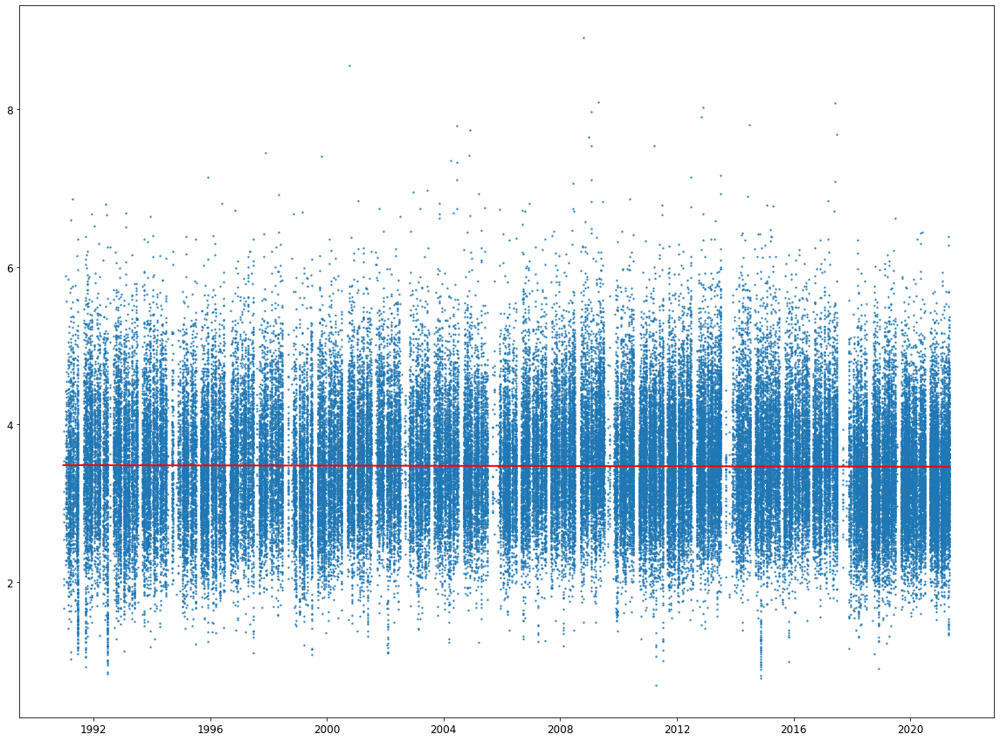

In [139]:
plt.scatter(date, novelty, alpha = 0.8, s= 2)
plt.plot(date, Y_pred, color='red', linewidth = 2)
#plt.show()

    
plt.savefig("./figures/fit_novelty.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

In [173]:
Y_pred.shape

(114381, 1)

In [174]:
regression_df = df.copy()
regression_df["Y_pred"] = pd.Series(Y_pred.reshape(114381))

In [175]:
regression_df.head()

,novelty,date,time,ID,name,positionShort,politicianId,Y_pred
0,2.654964,1990-12-20,661647600.0,471527,dregger,Member of Parliament,11000418,2.971282
1,2.740302,1990-12-20,661647600.0,471532,ullmann,Member of Parliament,11002354,2.971282
2,2.864003,1990-12-20,661647600.0,471536,heuer,Member of Parliament,11000891,2.971282
3,3.236273,1990-12-20,661647600.0,471538,bohl,Member of Parliament,11000230,2.971282
4,2.712968,1990-12-20,661647600.0,471540,struck,Member of Parliament,11002278,2.971282


In [ ]:
#regression_df['Y_pred']

In [176]:
regression_df["Delta_Y"] = regression_df['novelty'] - regression_df['Y_pred']

regression_df.head()

,novelty,date,time,ID,name,positionShort,politicianId,Y_pred,Delta_Y
0,2.654964,1990-12-20,661647600.0,471527,dregger,Member of Parliament,11000418,2.971282,-0.316318
1,2.740302,1990-12-20,661647600.0,471532,ullmann,Member of Parliament,11002354,2.971282,-0.230980
2,2.864003,1990-12-20,661647600.0,471536,heuer,Member of Parliament,11000891,2.971282,-0.107279
3,3.236273,1990-12-20,661647600.0,471538,bohl,Member of Parliament,11000230,2.971282,0.264990
4,2.712968,1990-12-20,661647600.0,471540,struck,Member of Parliament,11002278,2.971282,-0.258314


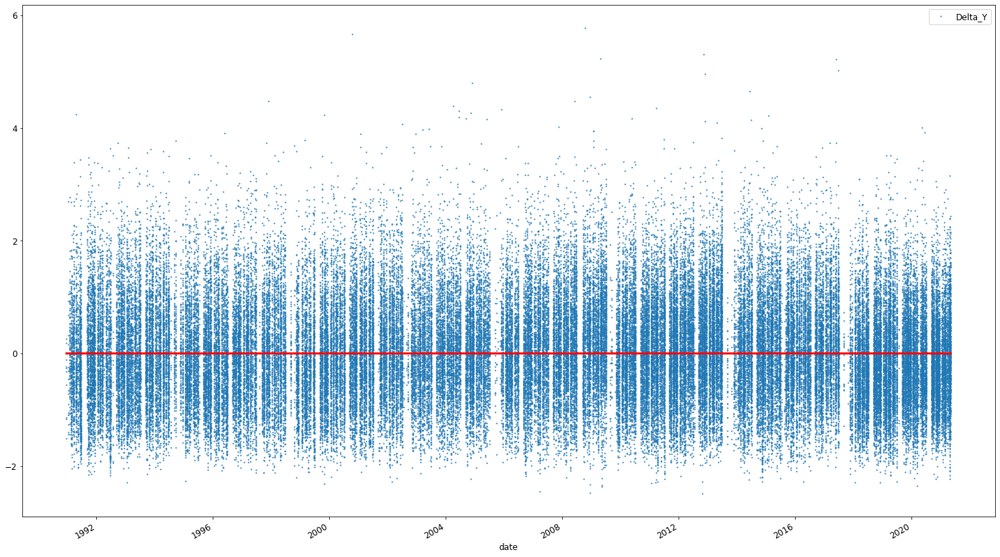

In [177]:
regression_df.plot("date", "Delta_Y", marker = "o", linewidth = 0, ms = 1)
plt.plot(date, np.zeros(len(date)), color='red', linewidth = 3)

plt.savefig("./figures/novelty_residuals.png", dpi=300, facecolor='w', 
            edgecolor='w', orientation='portrait', format=None, 
            transparent=False, pad_inches=0.1)

#### Other model

In [178]:
from statsmodels.compat import lzip
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.formula.api import ols

plt.rc("figure", figsize=(16,8))
plt.rc("font", size=14)

In [179]:
df.head()

,novelty,date,time,ID,name,positionShort,politicianId
0,2.654964,1990-12-20,661647600.0,471527,dregger,Member of Parliament,11000418
1,2.740302,1990-12-20,661647600.0,471532,ullmann,Member of Parliament,11002354
2,2.864003,1990-12-20,661647600.0,471536,heuer,Member of Parliament,11000891
3,3.236273,1990-12-20,661647600.0,471538,bohl,Member of Parliament,11000230
4,2.712968,1990-12-20,661647600.0,471540,struck,Member of Parliament,11002278


In [180]:
novelty_model = ols("novelty ~ time", data=df).fit()
print(novelty_model.summary())

                            OLS Regression Results                            
Dep. Variable:                novelty   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     20.64
Date:                Thu, 22 Jul 2021   Prob (F-statistic):           5.54e-06
Time:                        11:10:21   Log-Likelihood:            -1.4870e+05
No. Observations:              114381   AIC:                         2.974e+05
Df Residuals:                  114379   BIC:                         2.974e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      2.9434      0.011    261.110      0.0

In [181]:
#fig = sm.graphics.influence_plot(novelty_model, criterion="cooks")
#fig.tight_layout(pad=1.0)